In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Data undersatanding

Reading the Application data

In [2]:
df = pd.read_csv("application_data.csv")

In [3]:
df.shape

(307511, 122)

In [4]:
df.info(max_cols=122)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Non-Null Count   Dtype  
---   ------                        --------------   -----  
 0    SK_ID_CURR                    307511 non-null  int64  
 1    TARGET                        307511 non-null  int64  
 2    NAME_CONTRACT_TYPE            307511 non-null  object 
 3    CODE_GENDER                   307511 non-null  object 
 4    FLAG_OWN_CAR                  307511 non-null  object 
 5    FLAG_OWN_REALTY               307511 non-null  object 
 6    CNT_CHILDREN                  307511 non-null  int64  
 7    AMT_INCOME_TOTAL              307511 non-null  float64
 8    AMT_CREDIT                    307511 non-null  float64
 9    AMT_ANNUITY                   307499 non-null  float64
 10   AMT_GOODS_PRICE               307233 non-null  float64
 11   NAME_TYPE_SUITE               306219 non-null  object 
 12   NAME_INCOME_TYPE            

Reading the previous application data

In [5]:
df_previous= pd.read_csv("previous_application.csv")

In [6]:
df_previous.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
df_previous.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

# Missing Values Analysis

In [8]:
df.isnull().sum()

SK_ID_CURR                        0
TARGET                            0
NAME_CONTRACT_TYPE                0
CODE_GENDER                       0
FLAG_OWN_CAR                      0
                              ...  
AMT_REQ_CREDIT_BUREAU_DAY     41519
AMT_REQ_CREDIT_BUREAU_WEEK    41519
AMT_REQ_CREDIT_BUREAU_MON     41519
AMT_REQ_CREDIT_BUREAU_QRT     41519
AMT_REQ_CREDIT_BUREAU_YEAR    41519
Length: 122, dtype: int64

In [9]:
total = df.isnull().sum().sort_values(ascending=False)
percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head(50)

,Total,Percent
COMMONAREA_MEDI,214865,0.698723
COMMONAREA_AVG,214865,0.698723
COMMONAREA_MODE,214865,0.698723
NONLIVINGAPARTMENTS_MODE,213514,0.694330
NONLIVINGAPARTMENTS_AVG,213514,0.694330
NONLIVINGAPARTMENTS_MEDI,213514,0.694330
FONDKAPREMONT_MODE,210295,0.683862
LIVINGAPARTMENTS_MODE,210199,0.683550
LIVINGAPARTMENTS_AVG,210199,0.683550
LIVINGAPARTMENTS_MEDI,210199,0.683550


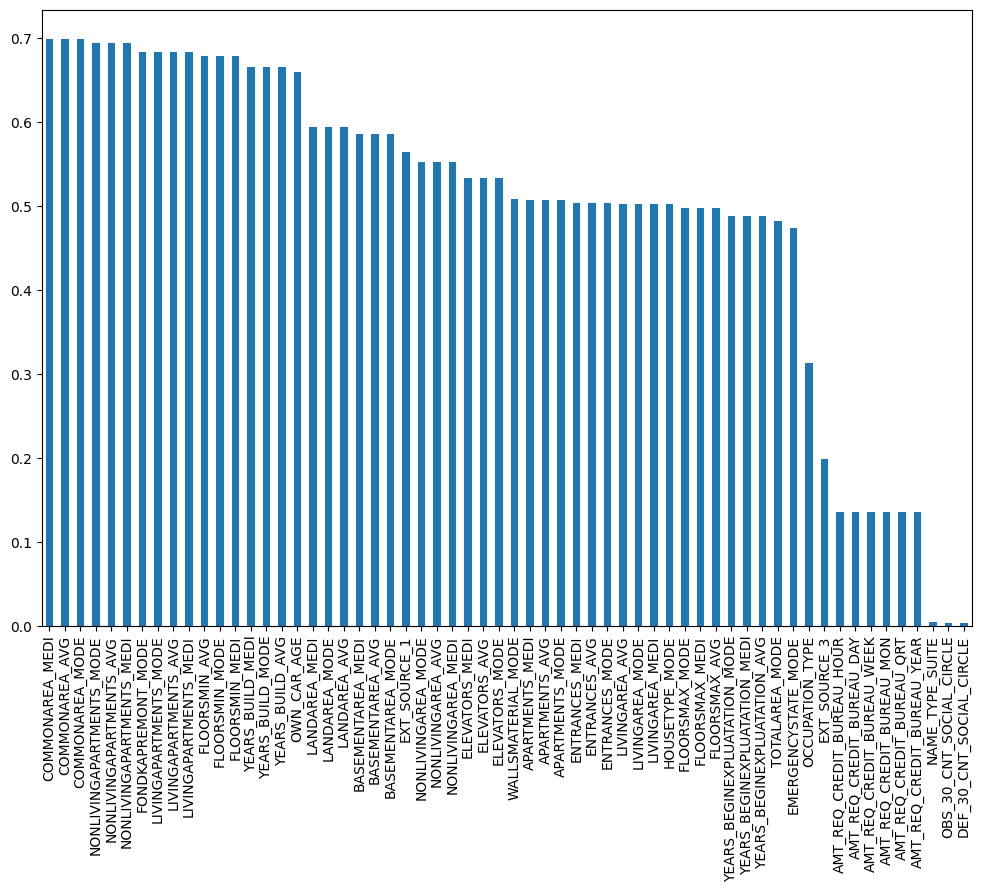

In [10]:
plt.figure(figsize=(12,8)) # set the figure size to 10 inches wide by 6 inches tall
percent[0:60].plot.bar()   # create the bar plot
plt.show() 

Here we can observe the top 60 missing value columns from the provided dataset.

Based on the figure. Almost 50 columns in the dataset have more than 50 percent of the data missing.



We can generally consider these methods to fill the missing values:

For numerical variables: imputation using mean or median

For categorical variables: imputation using mode

But since it's for analysis, we do not need to impute the data.
As the analysis would not be accurate based on the imputed data




# Missing values for previous application data

In [11]:
total = df_previous.isnull().sum().sort_values(ascending=False)
percent = (df_previous.isnull().sum()/df_previous.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head(50)

,Total,Percent
RATE_INTEREST_PRIVILEGED,1664263,9.964370e-01
RATE_INTEREST_PRIMARY,1664263,9.964370e-01
AMT_DOWN_PAYMENT,895844,5.363648e-01
RATE_DOWN_PAYMENT,895844,5.363648e-01
NAME_TYPE_SUITE,820405,4.911975e-01
NFLAG_INSURED_ON_APPROVAL,673065,4.029813e-01
DAYS_TERMINATION,673065,4.029813e-01
DAYS_LAST_DUE,673065,4.029813e-01
DAYS_LAST_DUE_1ST_VERSION,673065,4.029813e-01
DAYS_FIRST_DUE,673065,4.029813e-01


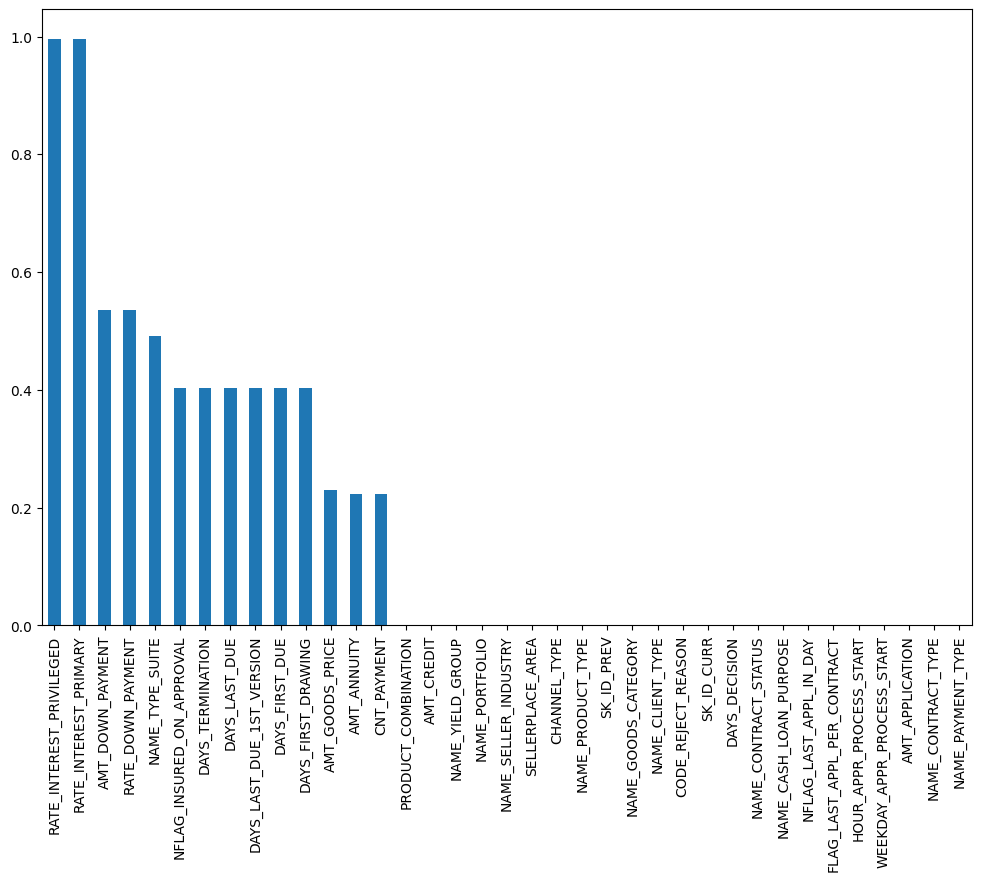

In [12]:
plt.figure(figsize=(12,8)) # set the figure size to 10 inches wide by 6 inches tall
percent.plot.bar()   # create the bar plot
plt.show() 

# Data Imbalance

For the Analysing the imabalnce in the dataset we need to identify the Numerical value and categorical value columns


In [13]:
num_cols = []
cat_cols = []

# loop through the columns of the DataFrame
for col in df.columns:
    if len(df[col].value_counts())<20:
        cat_cols.append(col)  # add the column name to num_cols if it is numerical
    else:
        num_cols.append(col)  # add the column name to cat_cols if it is categorical

# print the results
print('Numerical columns:', num_cols)
print('Categorical columns:', cat_cols)

Numerical columns: ['SK_ID_CURR', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'OWN_CAR_AGE', 'HOUR_APPR_PROCESS_START', 'ORGANIZATION_TYPE', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', '

In [14]:
num_cols2 =[]
cat_cols2 =[]
for col in df.columns:
    if len(df[col].value_counts())<20:
        cat_cols2.append(col)
    
    elif pd.api.types.is_numeric_dtype(df[col]):
        num_cols2.append(col)  # add the column name to num_cols if it is numerical
    else:
        cat_cols2.append(col)  # add the column name to cat_cols if it is categorical

# print the results
print('Numerical columns:', num_cols2)
print('Categorical columns:', cat_cols2)

Numerical columns: ['SK_ID_CURR', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'OWN_CAR_AGE', 'HOUR_APPR_PROCESS_START', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', 'ELEVATORS_MEDI', 'ENT

In [15]:
num_cols_previous = []
cat_cols_previous = []
for col in df_previous.columns:
    if len(df_previous[col].value_counts())<20:
        cat_cols_previous.append(col)
    
    elif pd.api.types.is_numeric_dtype(df_previous[col]):
        num_cols_previous.append(col)  # add the column name to num_cols if it is numerical
    else:
        cat_cols_previous.append(col)  # add the column name to cat_cols if it is categorical

# print the results
print('Numerical columns:', num_cols_previous)
print('Categorical columns:', cat_cols_previous)

Numerical columns: ['SK_ID_PREV', 'SK_ID_CURR', 'AMT_ANNUITY', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_DOWN_PAYMENT', 'AMT_GOODS_PRICE', 'HOUR_APPR_PROCESS_START', 'RATE_DOWN_PAYMENT', 'RATE_INTEREST_PRIMARY', 'RATE_INTEREST_PRIVILEGED', 'DAYS_DECISION', 'SELLERPLACE_AREA', 'CNT_PAYMENT', 'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE', 'DAYS_LAST_DUE_1ST_VERSION', 'DAYS_LAST_DUE', 'DAYS_TERMINATION']
Categorical columns: ['NAME_CONTRACT_TYPE', 'WEEKDAY_APPR_PROCESS_START', 'FLAG_LAST_APPL_PER_CONTRACT', 'NFLAG_LAST_APPL_IN_DAY', 'NAME_CASH_LOAN_PURPOSE', 'NAME_CONTRACT_STATUS', 'NAME_PAYMENT_TYPE', 'CODE_REJECT_REASON', 'NAME_TYPE_SUITE', 'NAME_CLIENT_TYPE', 'NAME_GOODS_CATEGORY', 'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE', 'CHANNEL_TYPE', 'NAME_SELLER_INDUSTRY', 'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION', 'NFLAG_INSURED_ON_APPROVAL']


In [16]:
# Calculating gender imbalance ratio
ratio_of_gender_imbalance=(df[df.CODE_GENDER=='F'].CODE_GENDER.count())/(df[df.CODE_GENDER=='M'].CODE_GENDER.count())
print('The ratio of gender imbalance is ' +str(round(ratio_of_gender_imbalance,2)))

The ratio of gender imbalance is 1.93


# Univariate Analysis for categorical columns and Imbalance analysis

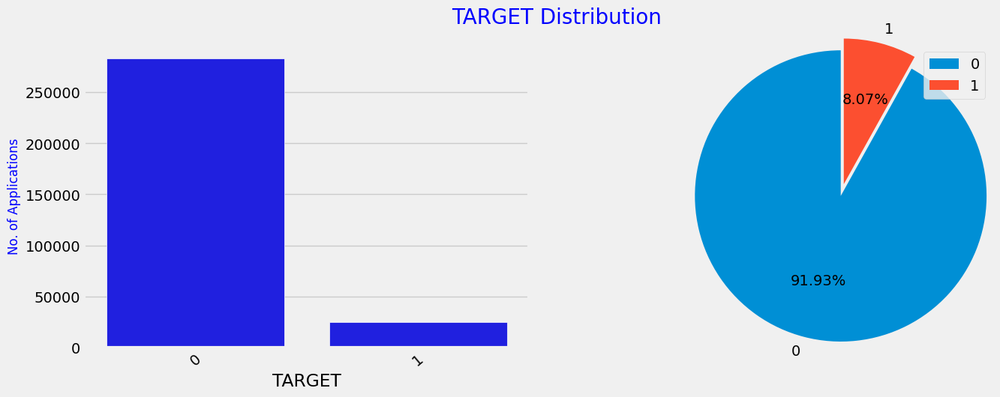

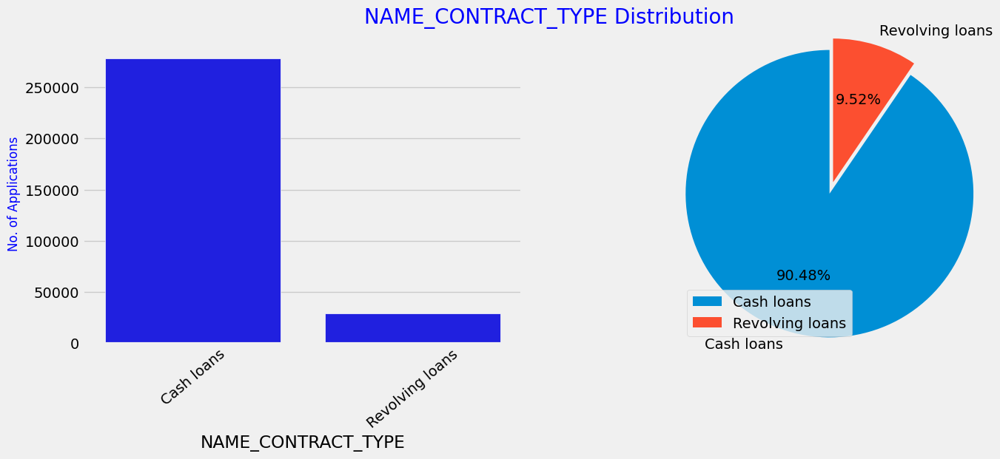

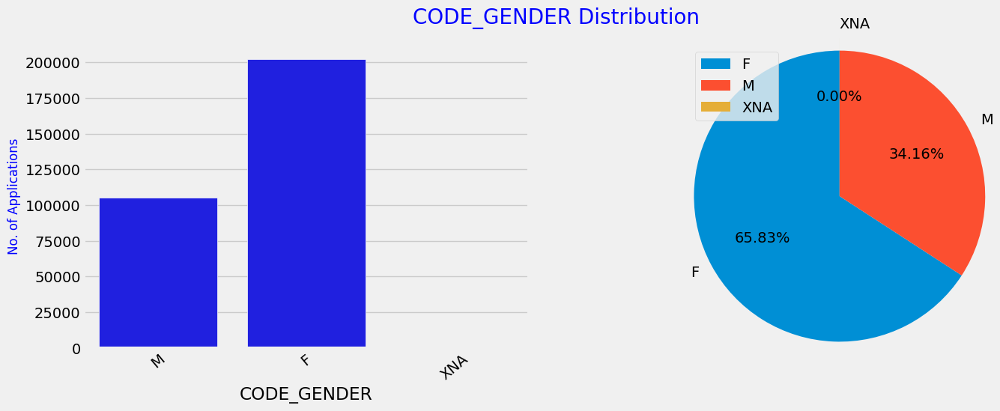

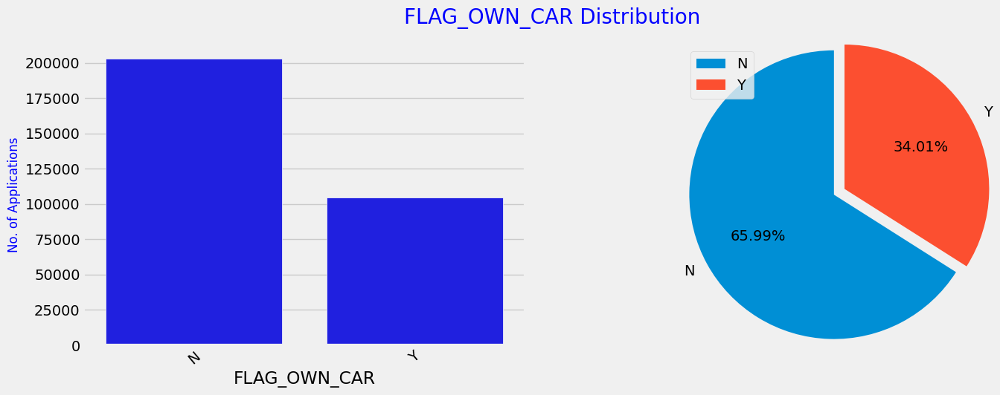

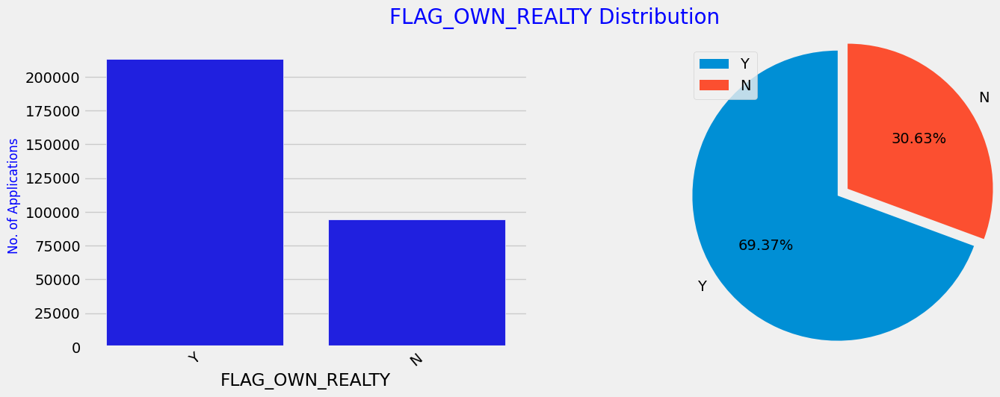

...

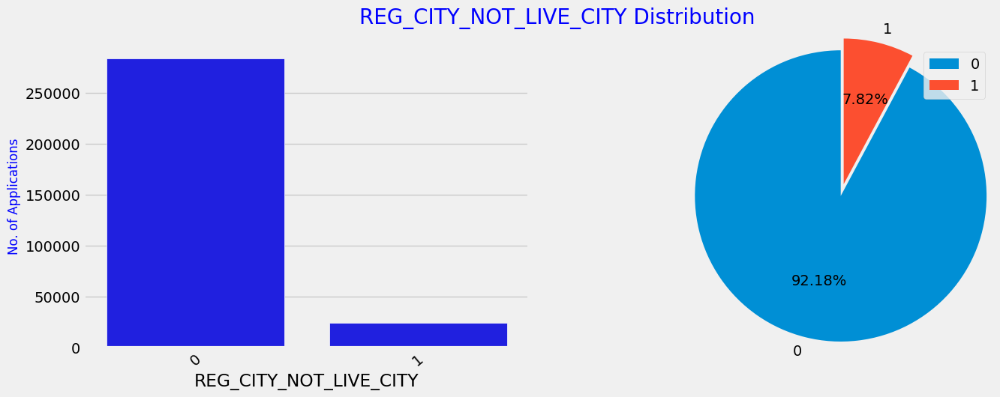

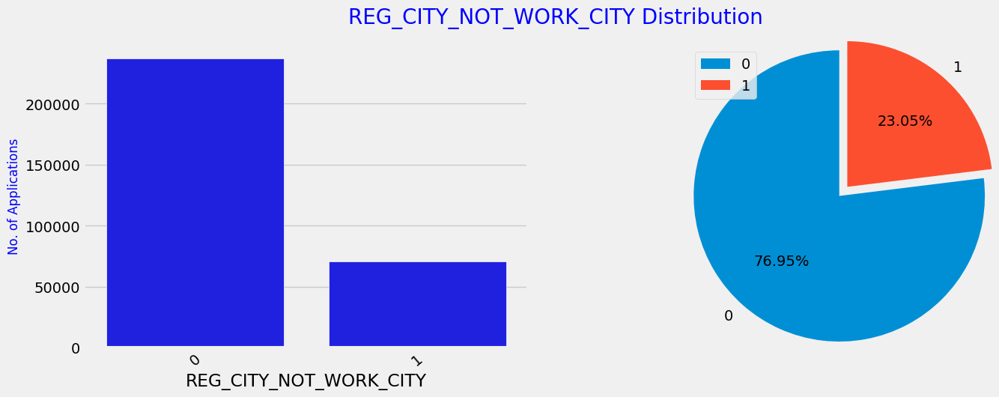

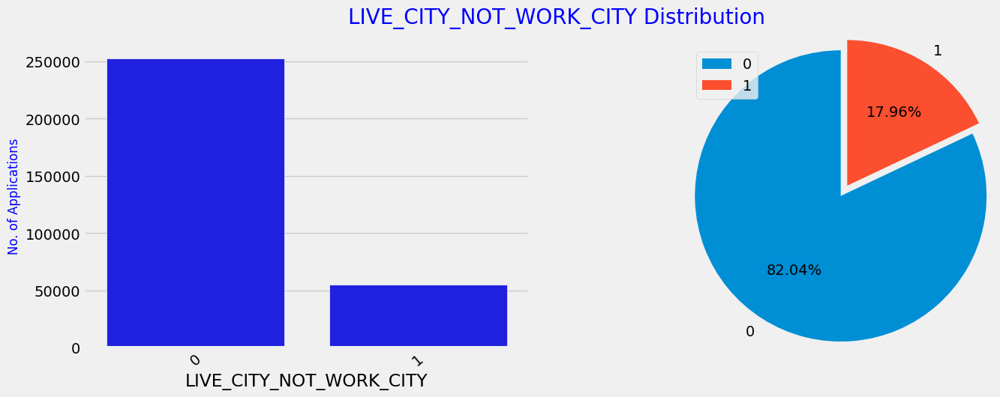

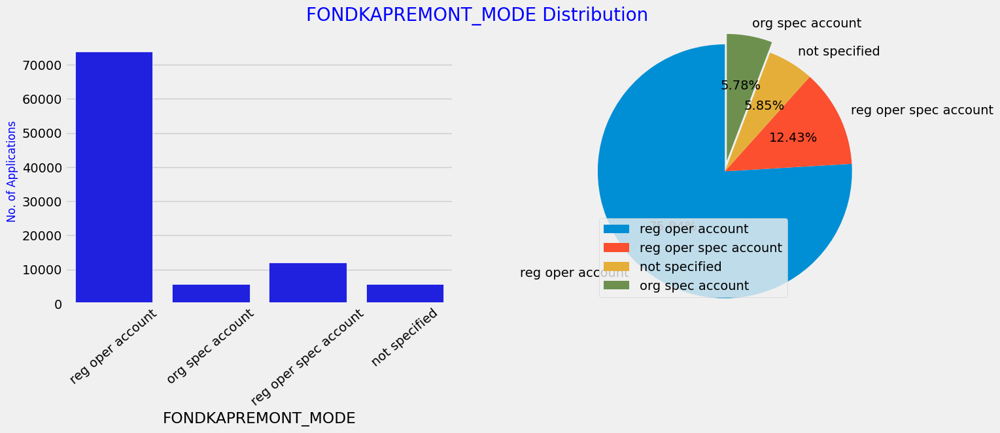

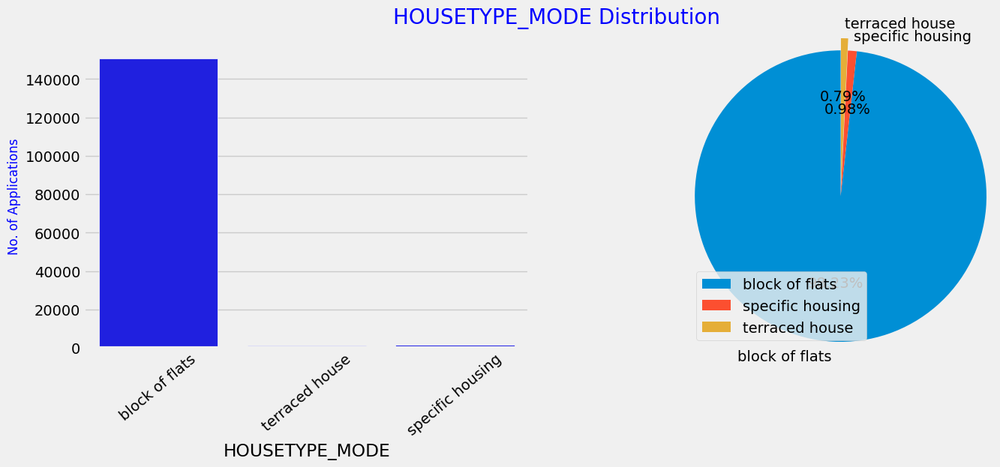

In [17]:
for col in cat_cols[0:30]:
    plt.style.use('fivethirtyeight')
    plt.figure(figsize=(15,5))

    plt.subplot(1,2,1)
    sns.countplot(x= col, color='blue',edgecolor='white', data= df)
    #plt.xlabel('Gender', fontsize=12, color='blue')
    plt.ylabel('No. of Applications', fontsize=12, color='blue')
    plt.xticks(rotation=40)
    plt.ticklabel_format(useOffset=False, style='plain', axis='y')

    plt.subplot(1,2,2)
    #mylabels=['Female','Male','XNA']
    num_columns = len(df[col].value_counts())
    explode = [0.1 if i == num_columns-1 else 0 for i in range(num_columns)]
    plt.pie(df[col].value_counts(),labels= df[col].value_counts().index,explode=explode,autopct='%0.2f%%',radius=1.2,startangle=90,textprops={'fontsize':14})
    plt.legend()
    plt.suptitle('{} Distribution\n'.format(col),fontsize=20, color='blue')
    plt.show()

The ratio of imbalance wrt TARGET variable is 11.39

The data has gender imbalance. The number of female applicants are almost double that of the male applicants.

Observations:

The dataset is highly imbalanced regarding the target variable, as there is a significant amount of data for loan applicants who are expected to repay the loan, but much less data for those who may struggle to do so. To address this issue, oversampling or undersampling techniques can be utilized.

In reality, the number of loan defaulters who cause banks' non-performing assets (NPA) is much smaller compared to the number of individuals who make timely repayments.

previous application data

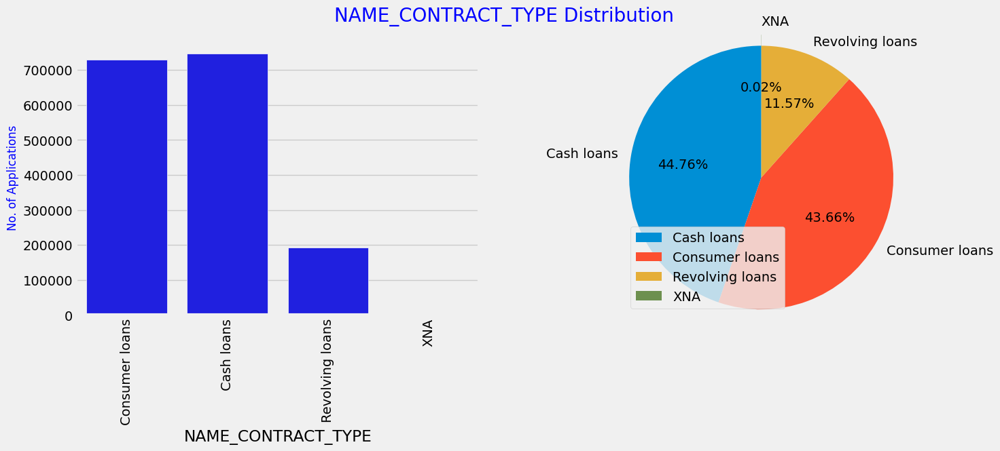

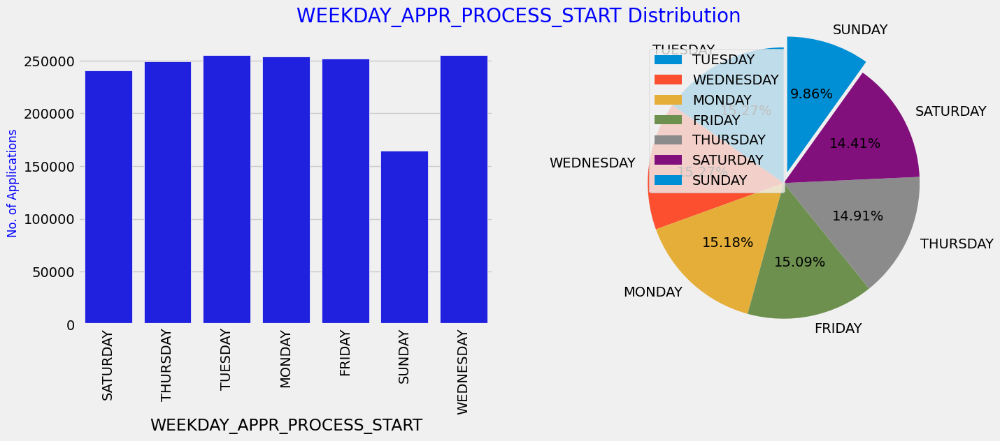

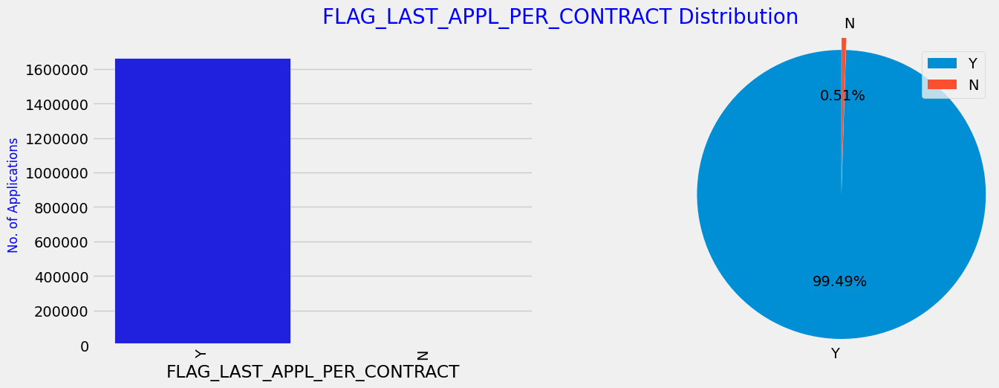

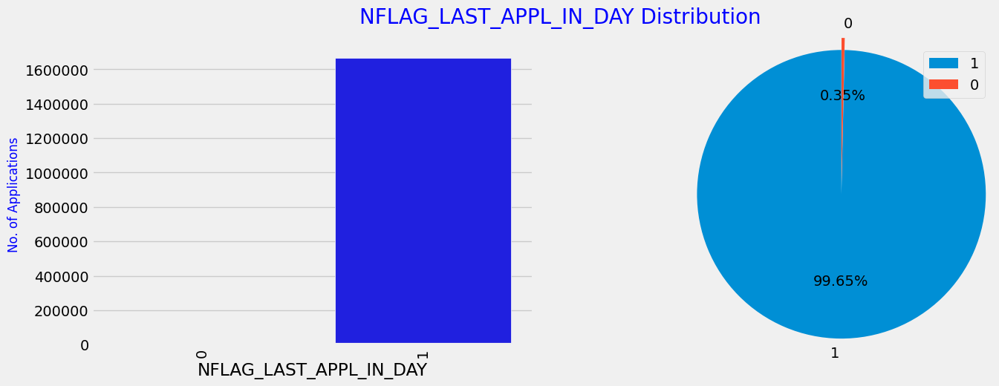

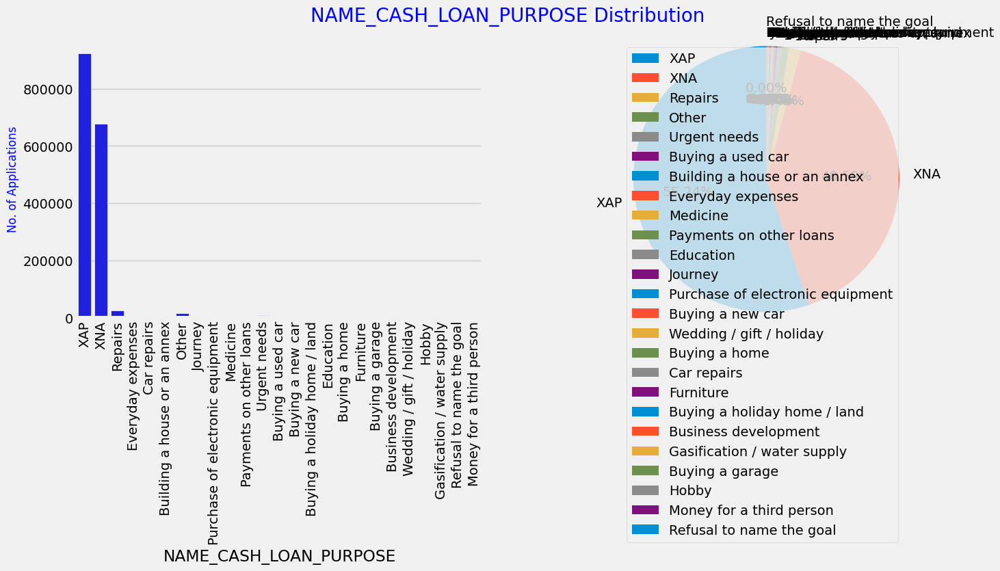

...

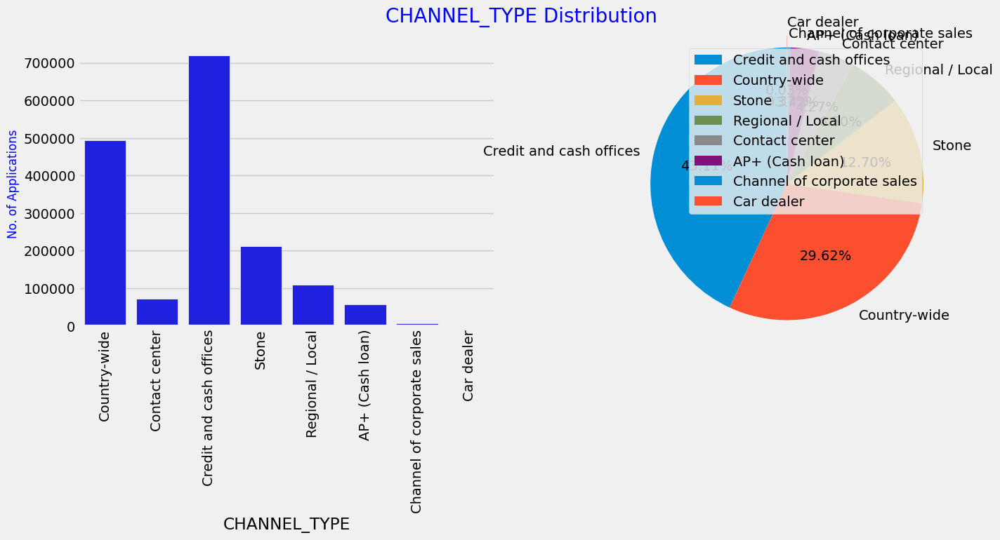

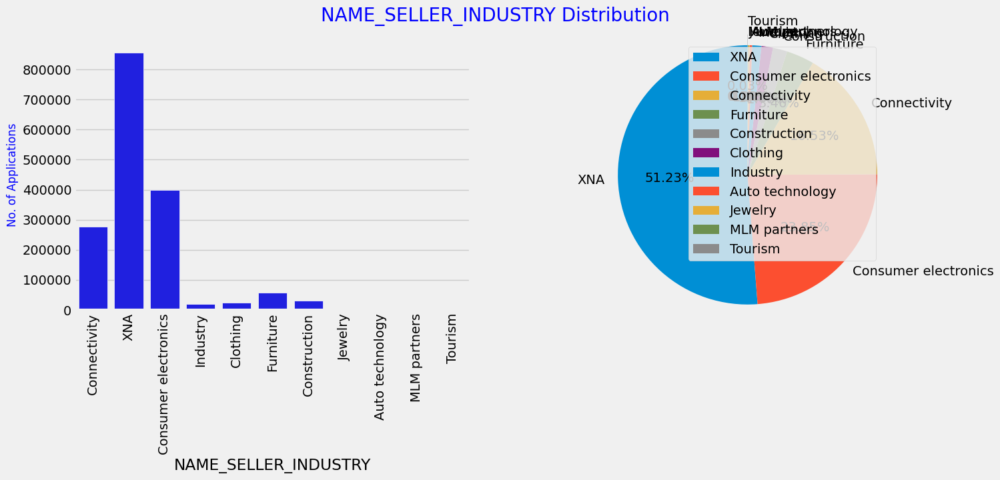

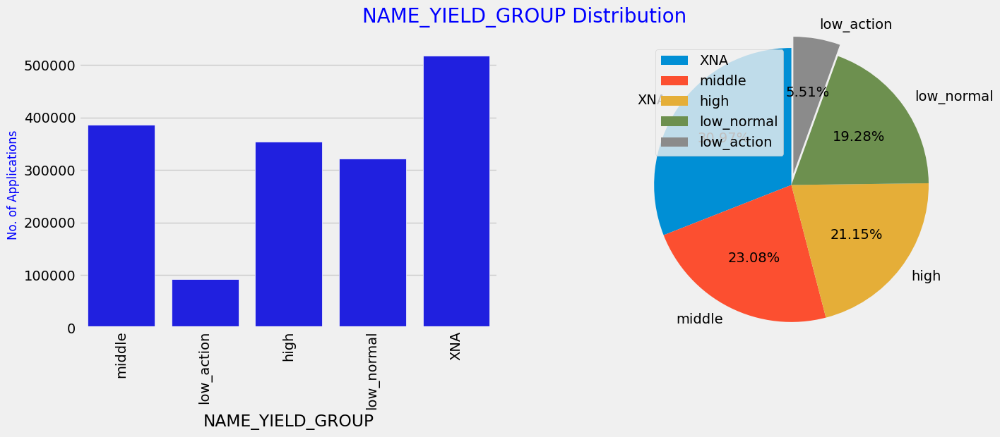

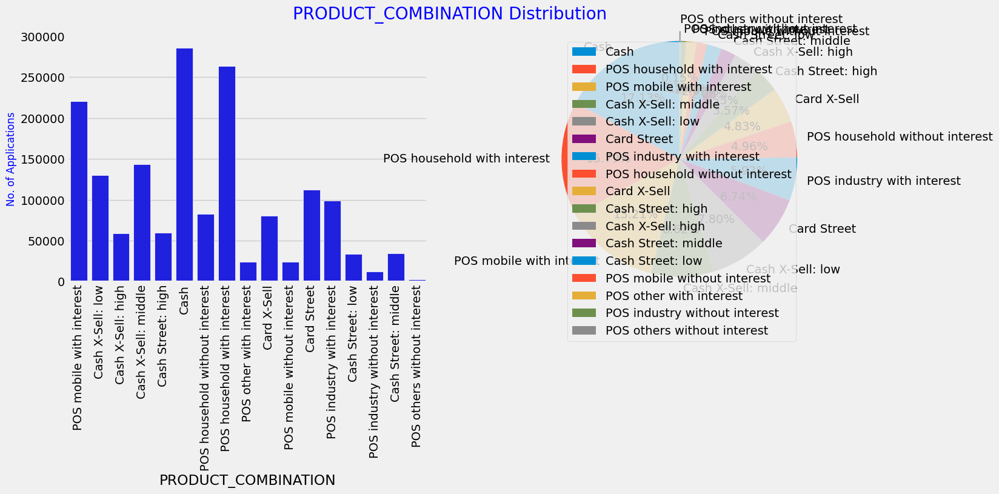

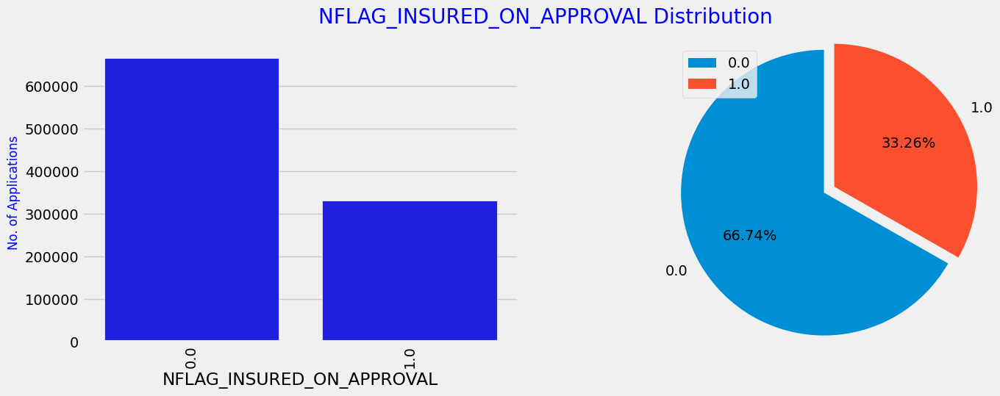

In [18]:
for col in cat_cols_previous:
    plt.style.use('fivethirtyeight')
    plt.figure(figsize=(15,5))

    plt.subplot(1,2,1)
    sns.countplot(x= col, color='blue',edgecolor='white', data= df_previous)
    #plt.xlabel('Gender', fontsize=12, color='blue')
    plt.ylabel('No. of Applications', fontsize=12, color='blue')
    plt.xticks(rotation=90)
    plt.ticklabel_format(useOffset=False, style='plain', axis='y')

    plt.subplot(1,2,2)
    #mylabels=['Female','Male','XNA']
    num_columns = len(df_previous[col].value_counts())
    explode = [0.1 if i == num_columns-1 else 0 for i in range(num_columns)]
    plt.pie(df_previous[col].value_counts(),labels= df_previous[col].value_counts().index,explode=explode,autopct='%0.2f%%',radius=1.2,startangle=90,textprops={'fontsize':14})
    plt.legend()
    plt.suptitle('{} Distribution\n'.format(col),fontsize=20, color='blue')
    plt.show()

Observations:
    
Majority of the previous loans are either cash loans or consumer loans.

Almost all the days of the week have equal distribution of loan applications except for sundays

Majority of the loan applications were approved

Most of the loan application are from the seller industry XNA

Through which channel we acquired the client on the previous application

most of the clients are acquired from the credit and cash offices followed by country-wide

# Univariate analysis for numerical columns and outliers Analysis

Univariate analysis for numerical columns and outliers Analysis in application data

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


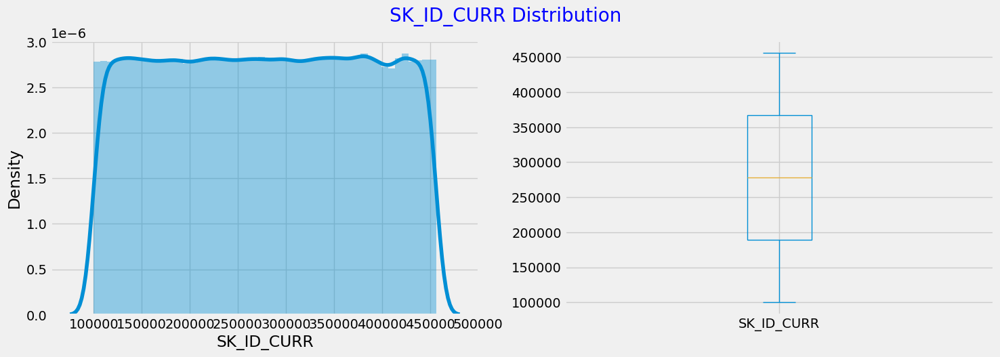

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


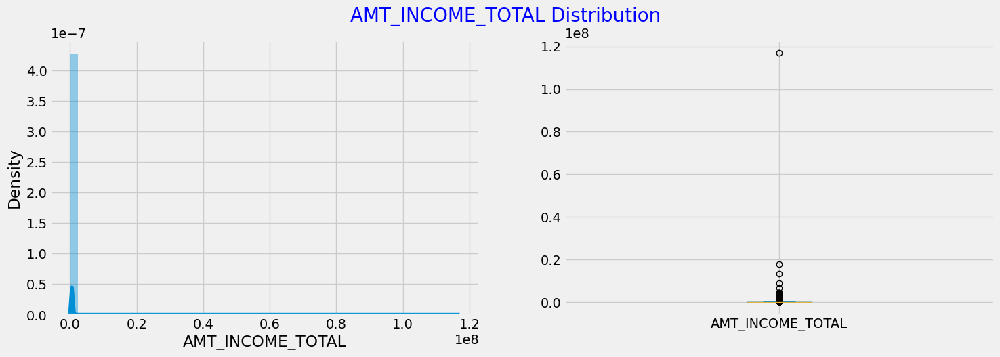

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


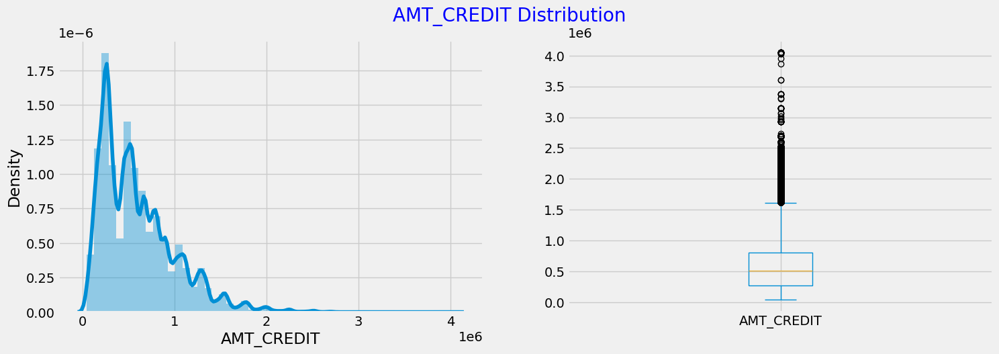

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


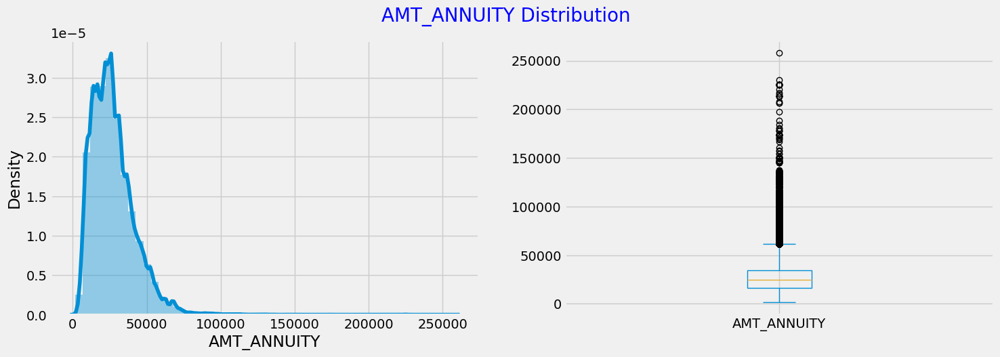

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


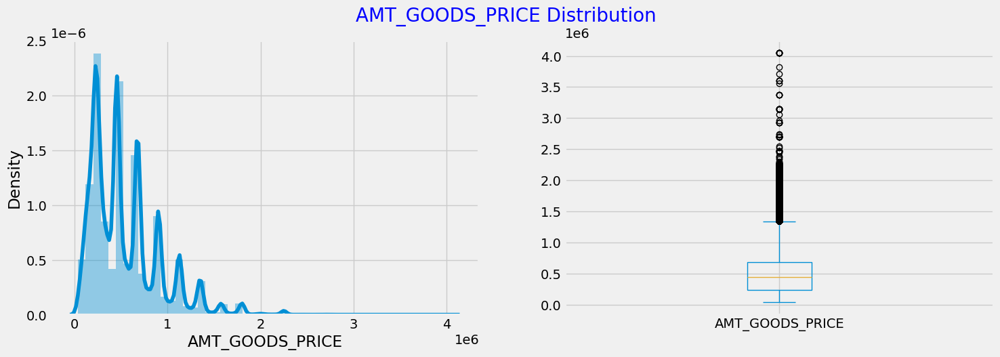

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


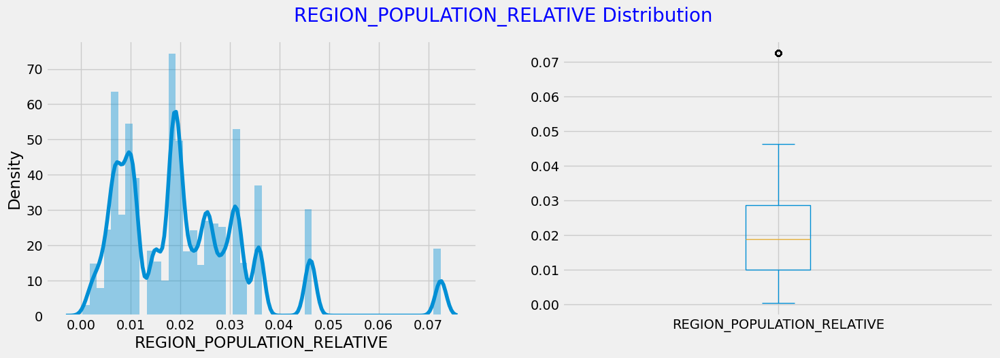

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


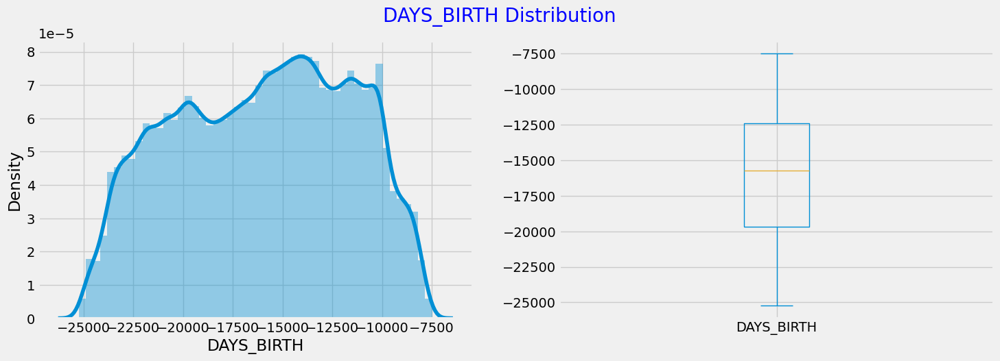

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


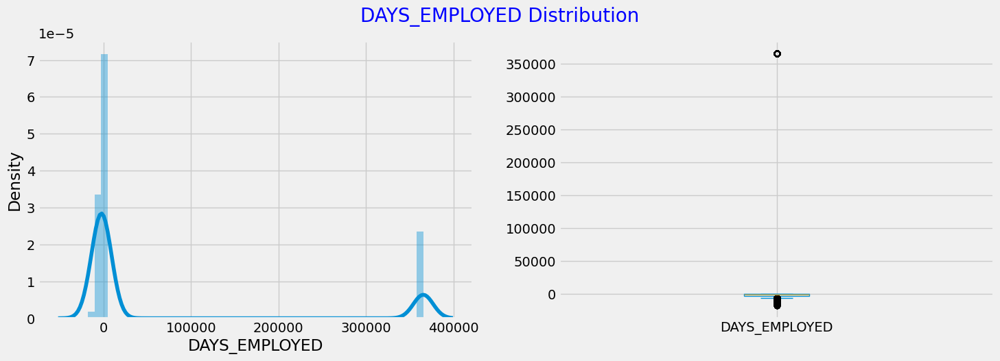

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


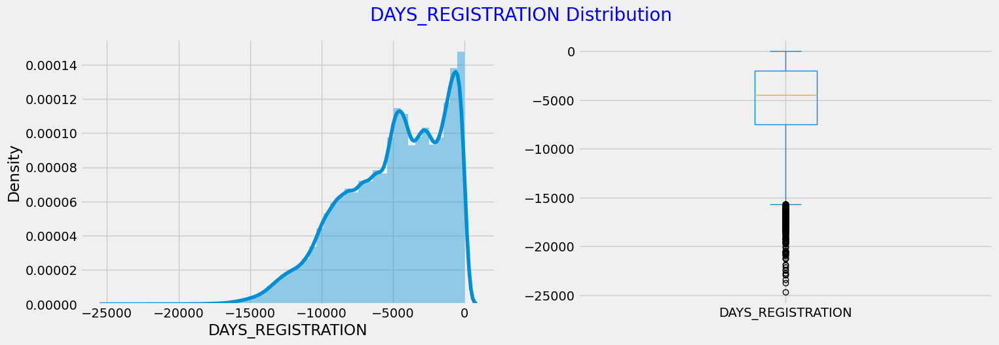

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


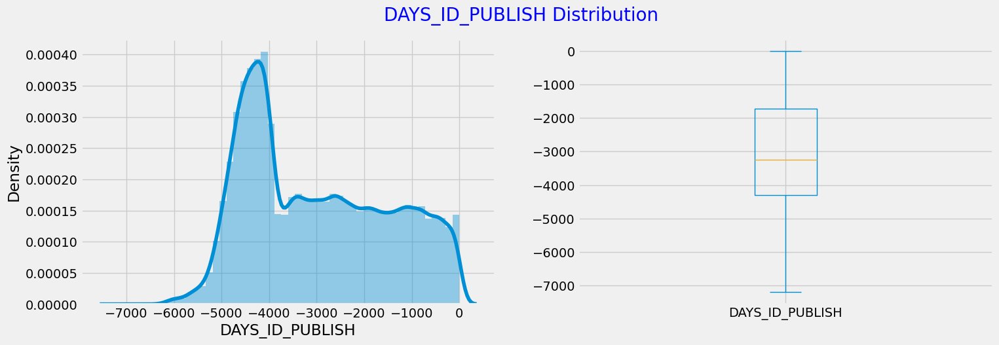

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


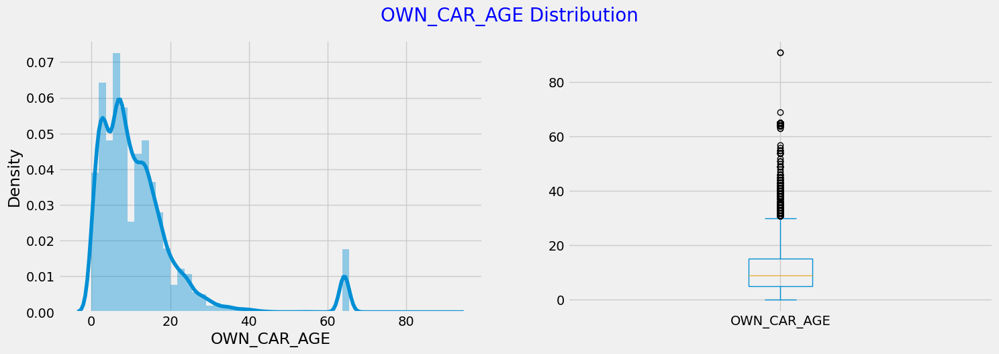

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


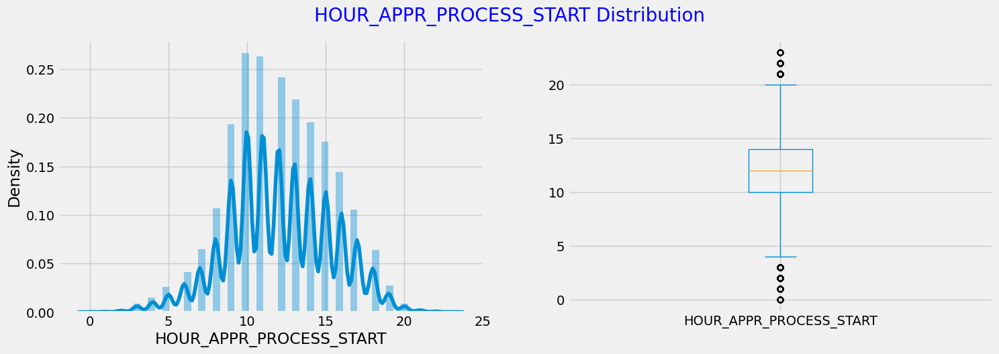

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


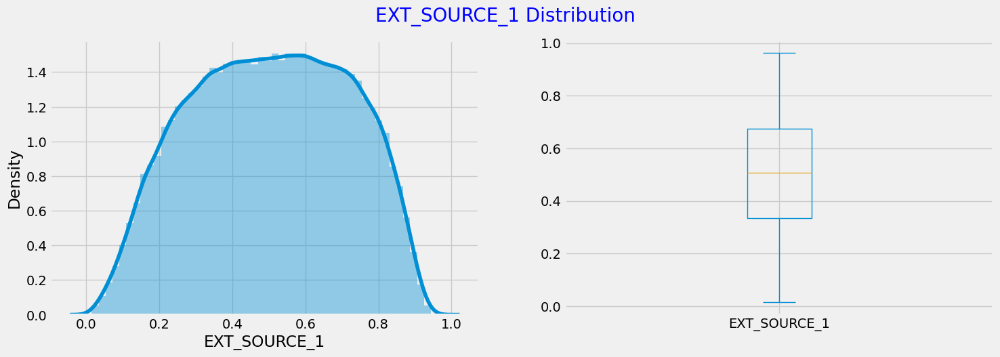

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


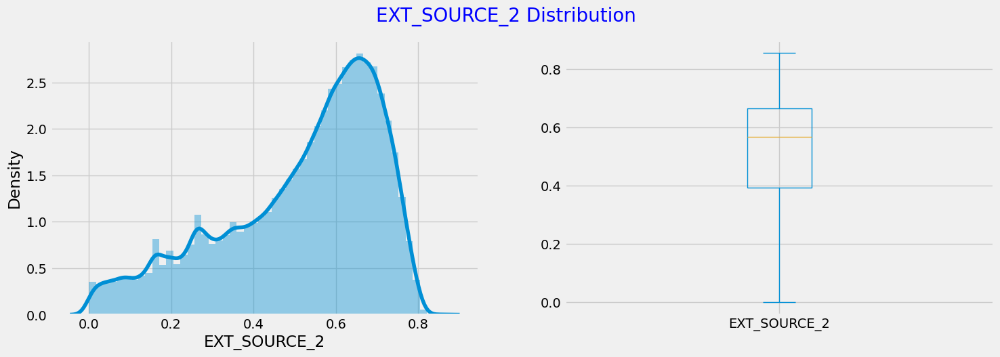

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


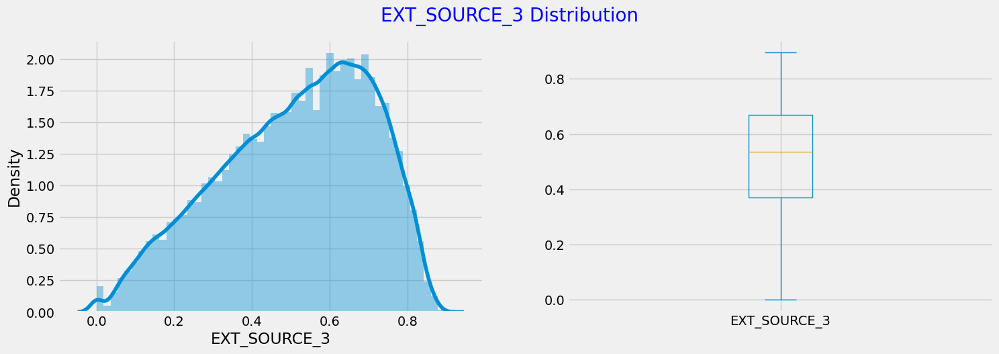

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


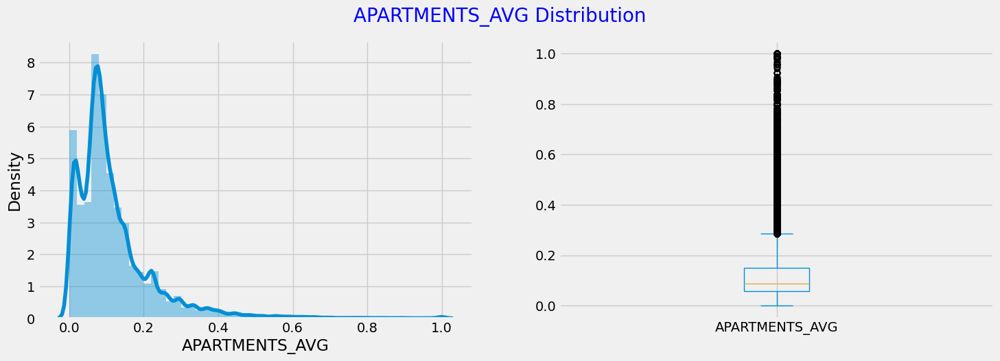

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


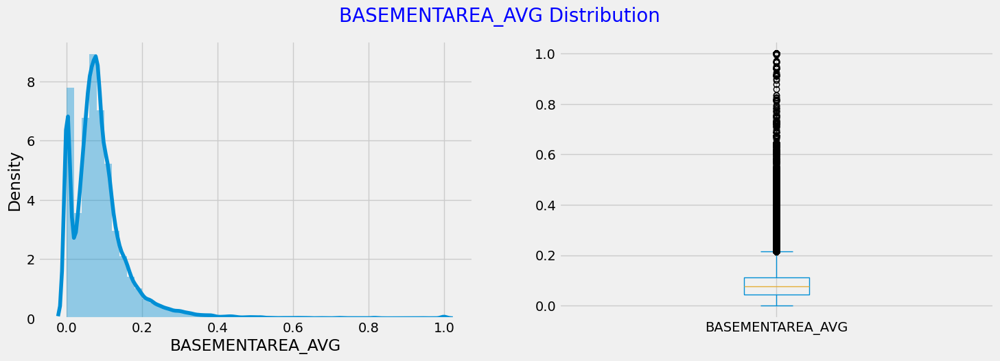

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


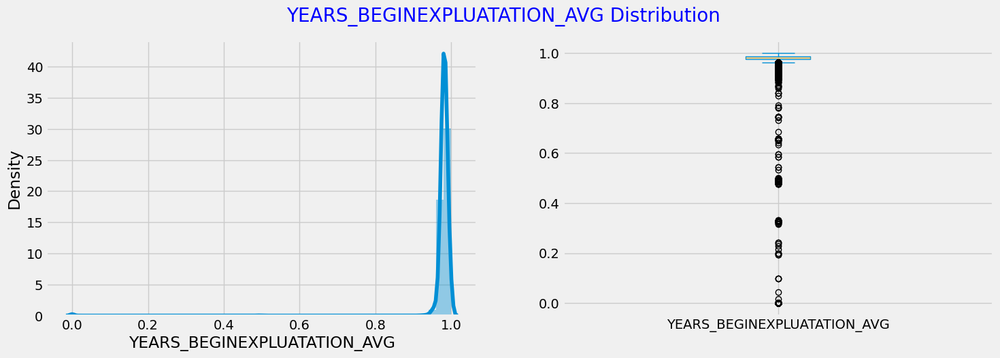

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


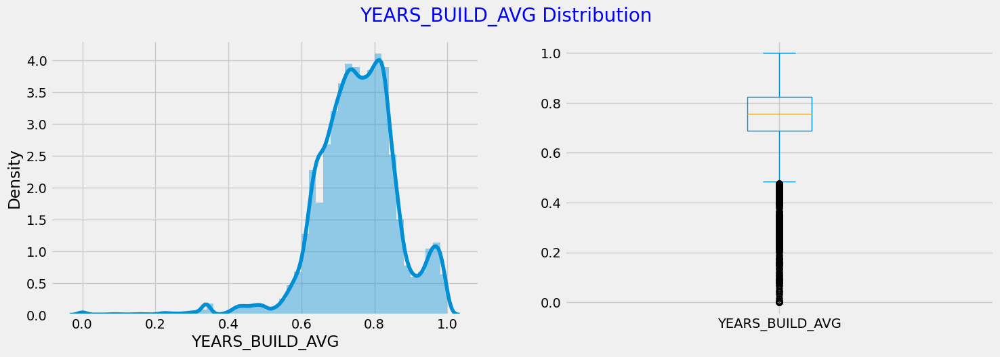

/tmp/ipykernel_18776/3993411084.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[col]);


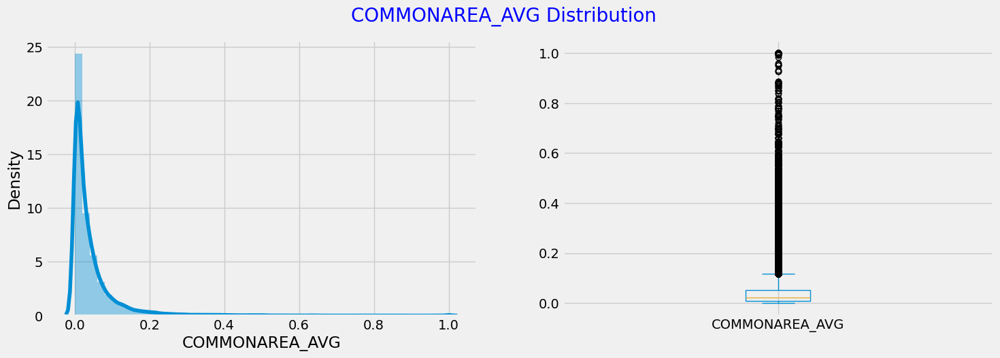

In [19]:
for col in num_cols2[0:20]:
    plt.subplot(121)
    sns.distplot(df[col]);

    plt.subplot(122)
    df[col].plot.box(figsize=(16,5))
    plt.suptitle('{} Distribution\n'.format(col),fontsize=20, color='blue')
    plt.show()

Observations:

As we can observe from the above graphs, Most of the columns have outliers and distribution is skewed.

1. Based on the days employed graph, it is apparent that an individual cannot be employed for more than 300,000 days. Consequently, any data points exceeding this value are considered outliers that may have entered the dataset due to errors. However, since there is no appropriate method to replace or impute these values, they are retained in their original form for the purpose of this analysis.

2. Having 10, 11, 12,14 and 19 children is highly unlikely. Therefore, these are possibly outliers

3. An income of 117000000 is unquestionably an extreme value, and it cannot be appropriately replaced with any other value. Therefore, it is retained as is without any modification.

Univariate analysis for numerical columns and outliers Analysis in previous application data

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


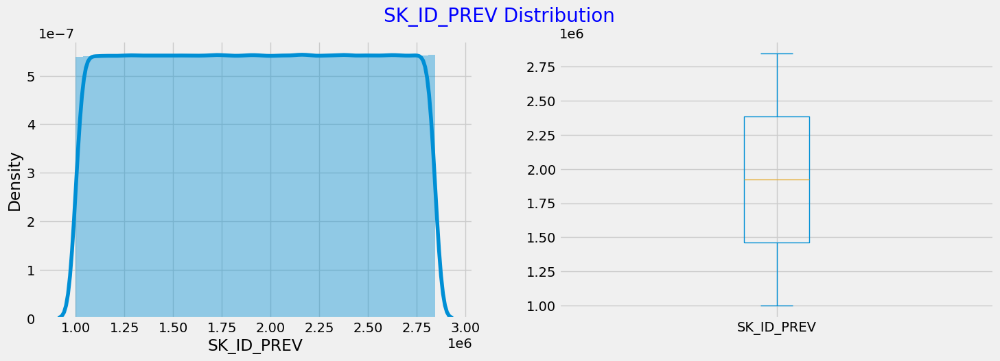

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


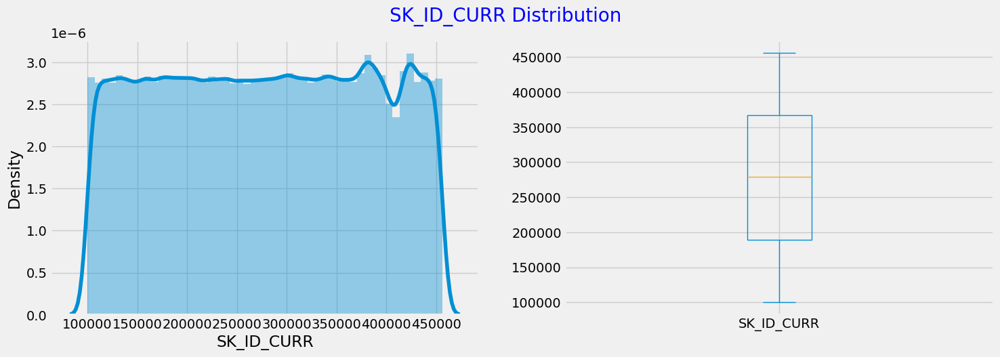

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


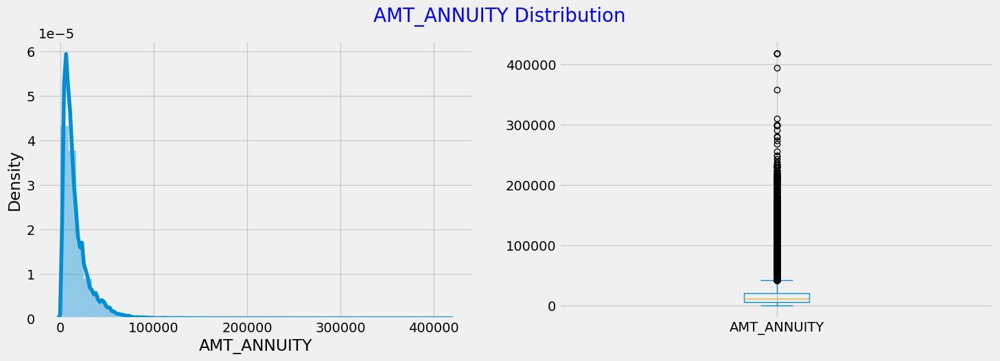

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


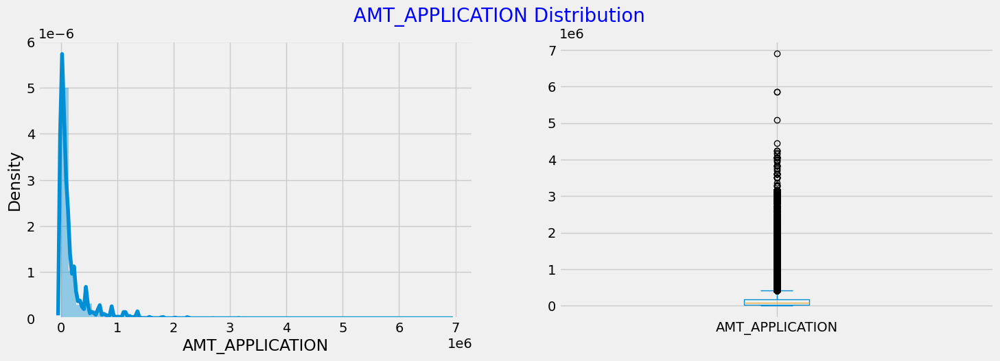

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


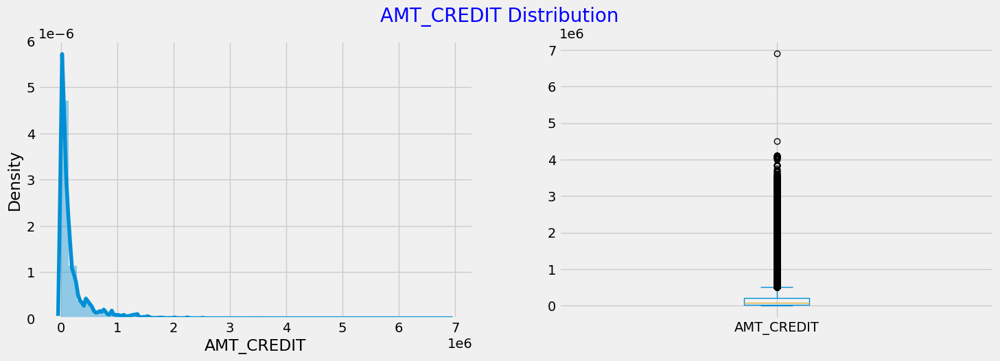

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


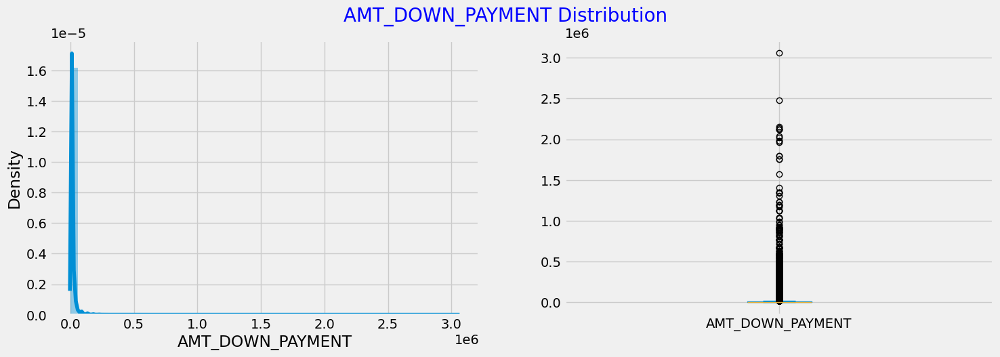

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


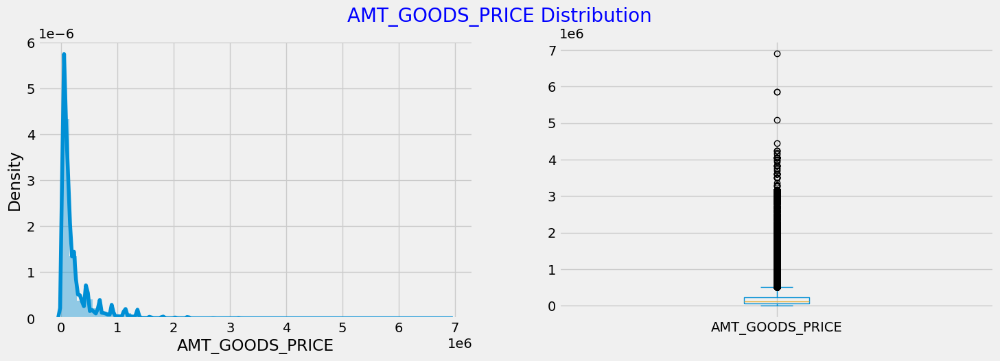

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


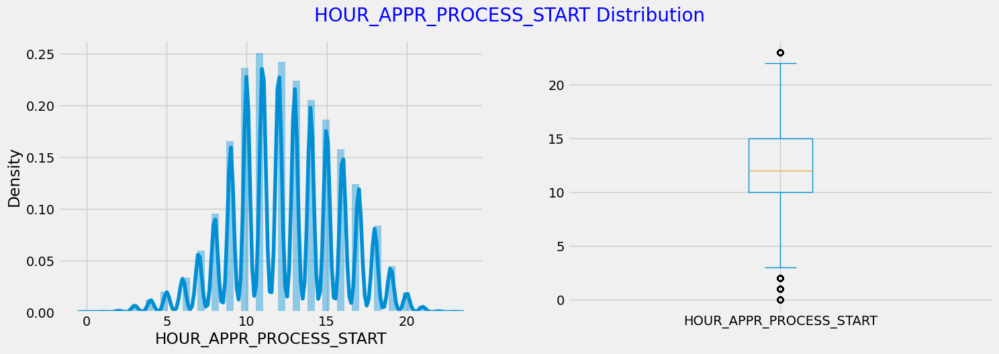

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


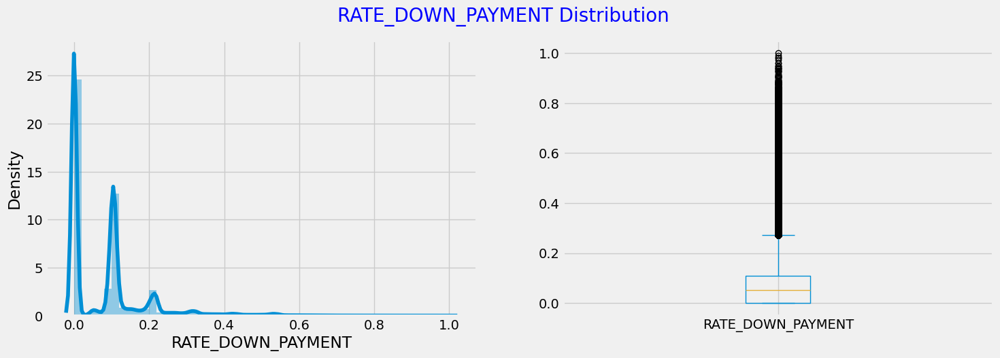

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


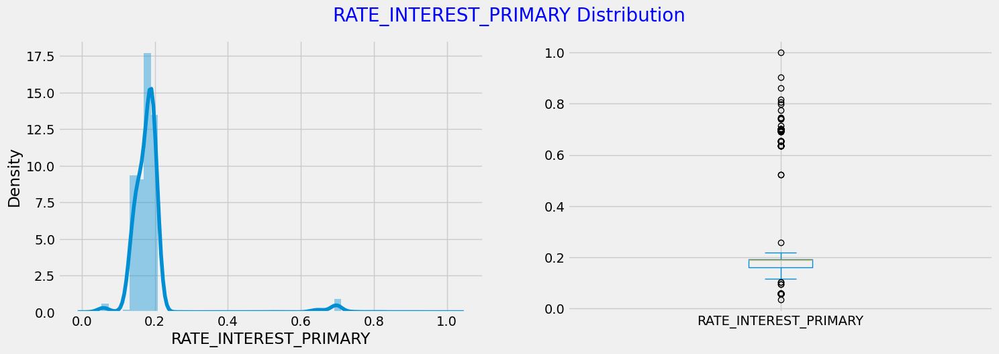

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


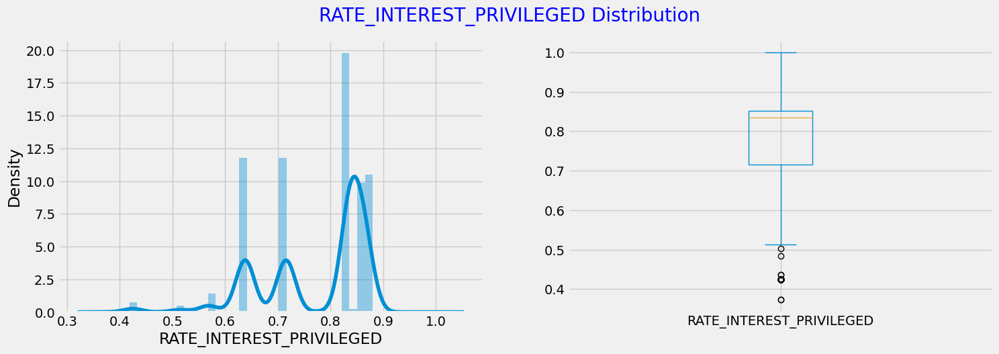

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


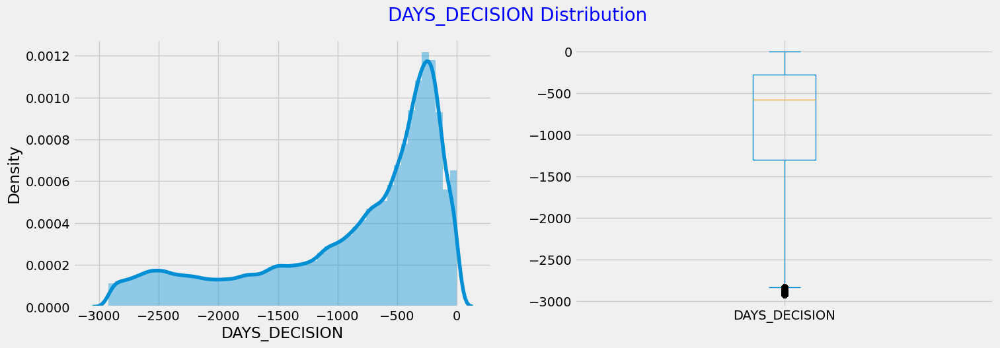

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


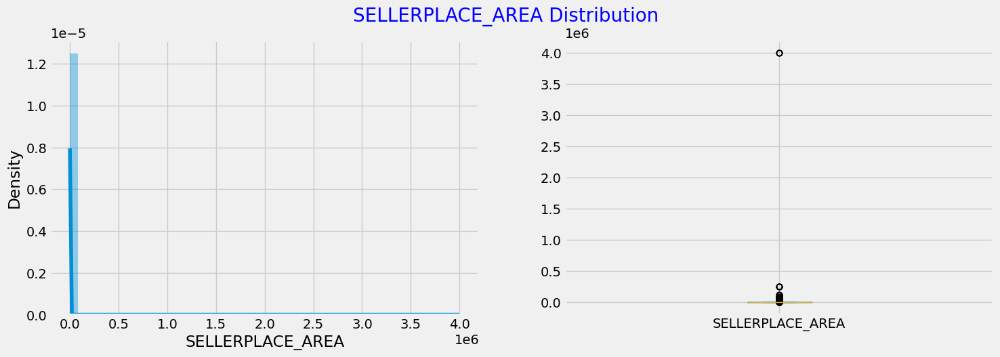

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


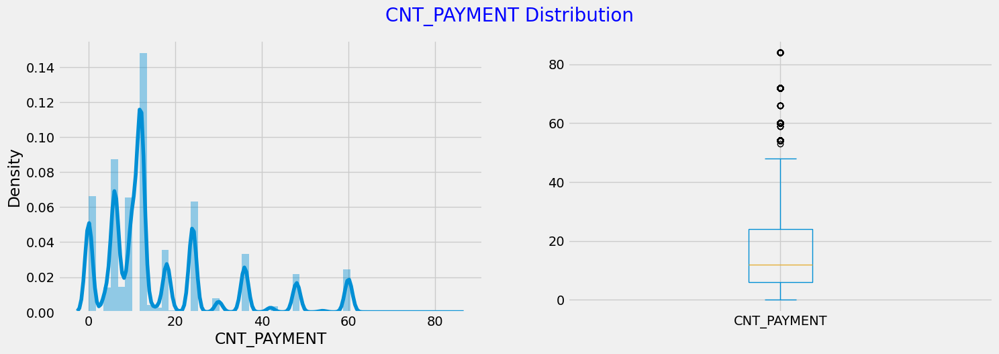

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


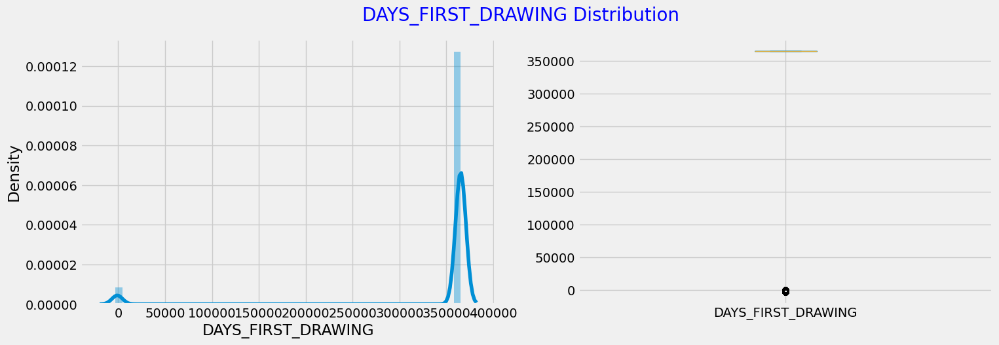

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


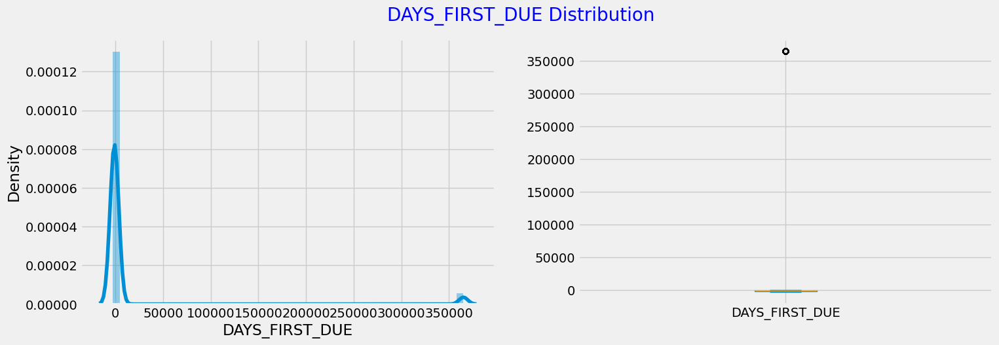

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


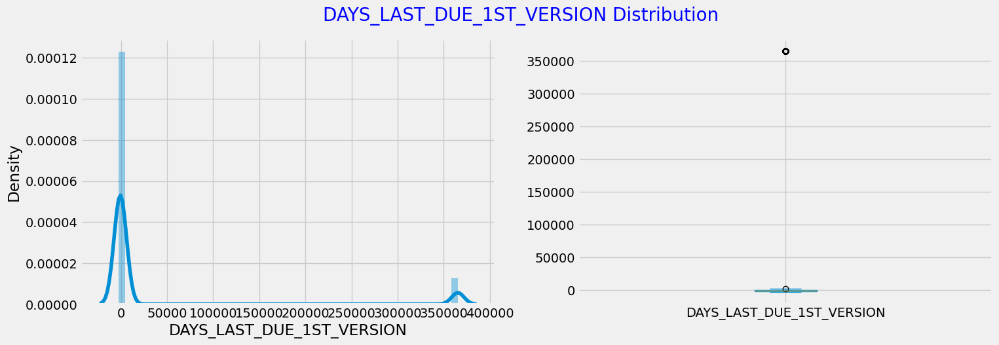

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


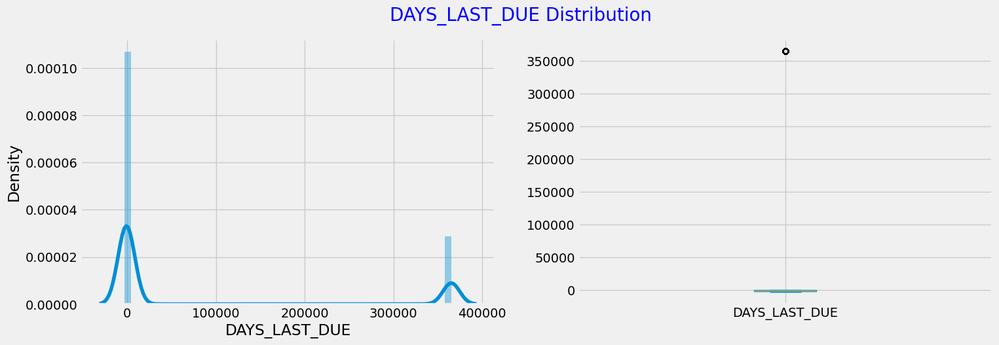

/tmp/ipykernel_18776/2916326577.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_previous[col]);


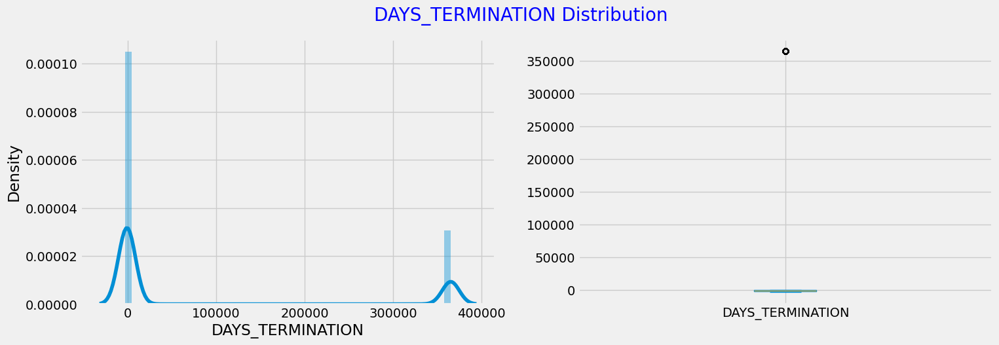

In [20]:
for col in num_cols_previous:
    plt.subplot(121)
    sns.distplot(df_previous[col]);

    plt.subplot(122)
    df_previous[col].plot.box(figsize=(16,5))
    plt.suptitle('{} Distribution\n'.format(col),fontsize=20, color='blue')
    plt.show()

Observations:

As we can observe from the above graphs,Even the previous application data most of the columns have outliers and distribution is skewed.

-The data contains numerous outliers, but it is not feasible to replace or fill in these values because each application is distinct and unique, and there is no suitable method to impute such highly discrete data.

-The dataset contains a significant number of outliers, which is understandable as individuals from various income brackets can apply for different types of loans to meet diverse needs.

-It appears that most of the loan applications are for amounts below 200,000. While there are many outliers present, they cannot be replaced or filled in as each application is unique, and there is no appropriate method for imputing such highly discrete data.

-Here also the no. of outliers are quite high which is expected. The trend here is similar to one the observed in application amount which is logically correct

# Bivariate analysis for categorical columns

Bi-Variate analysis of Application data

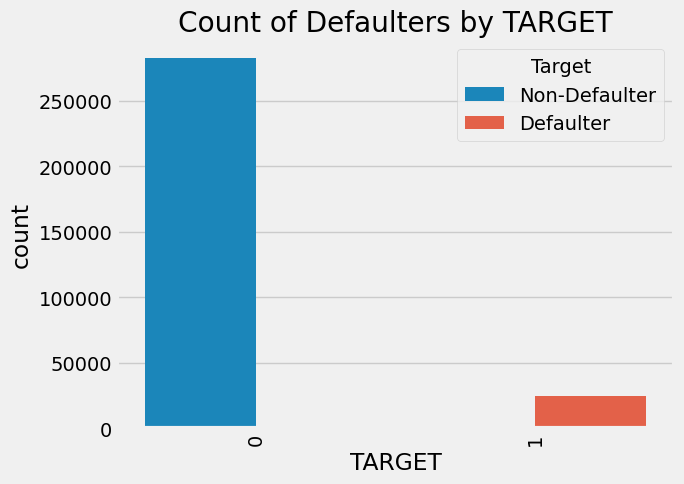

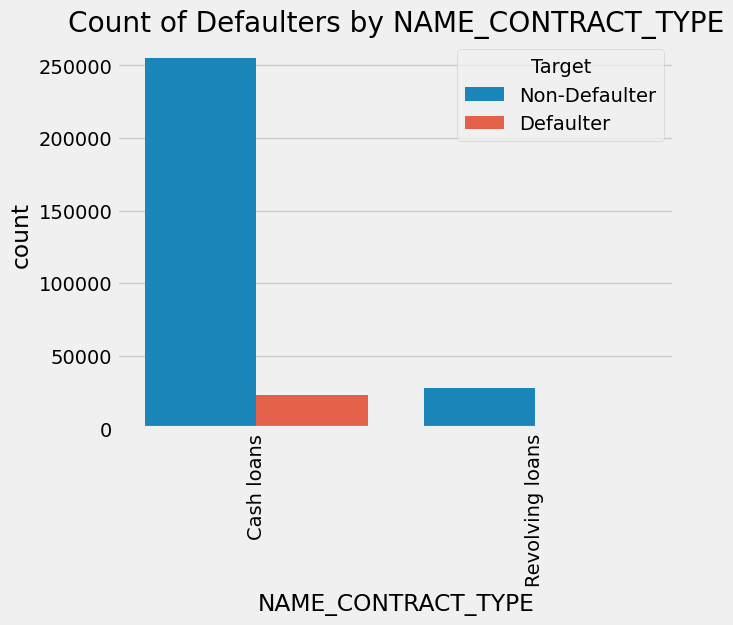

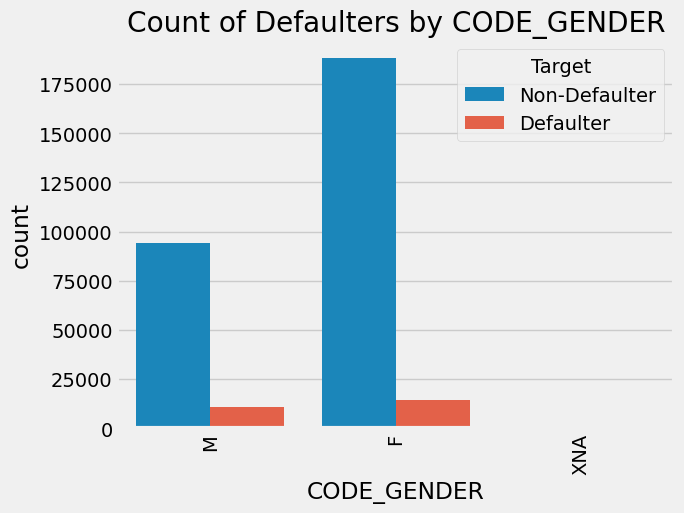

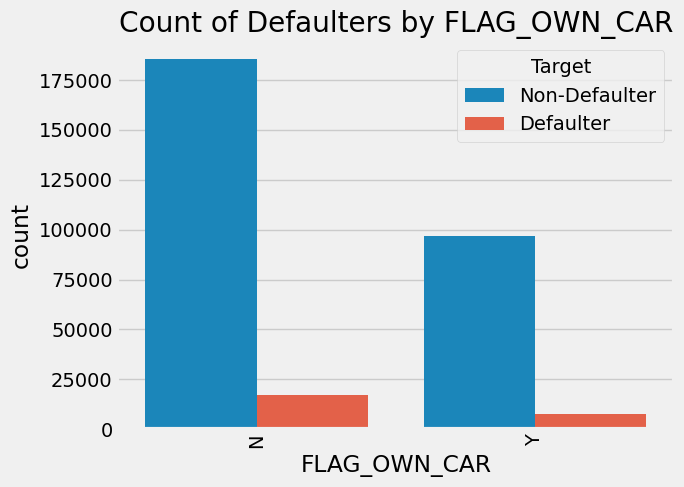

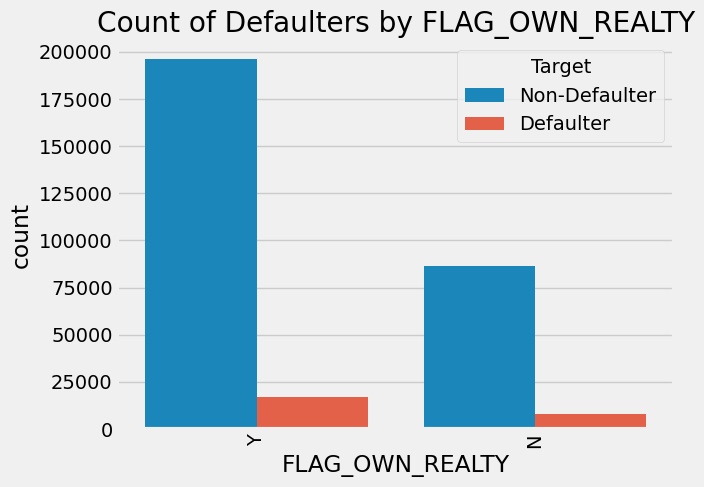

...

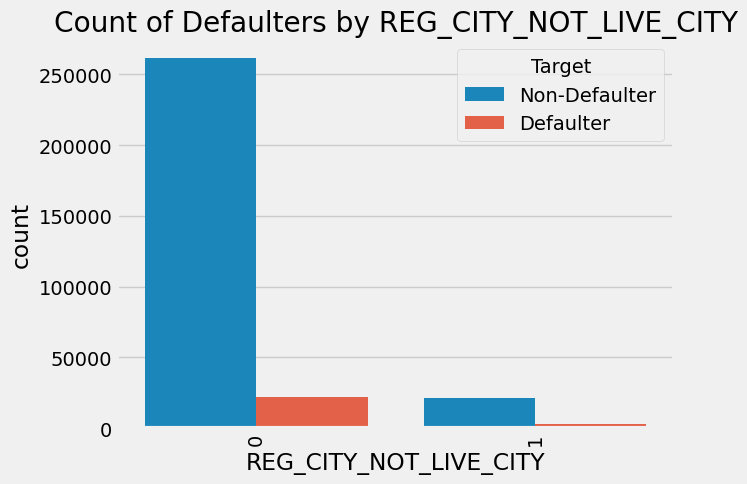

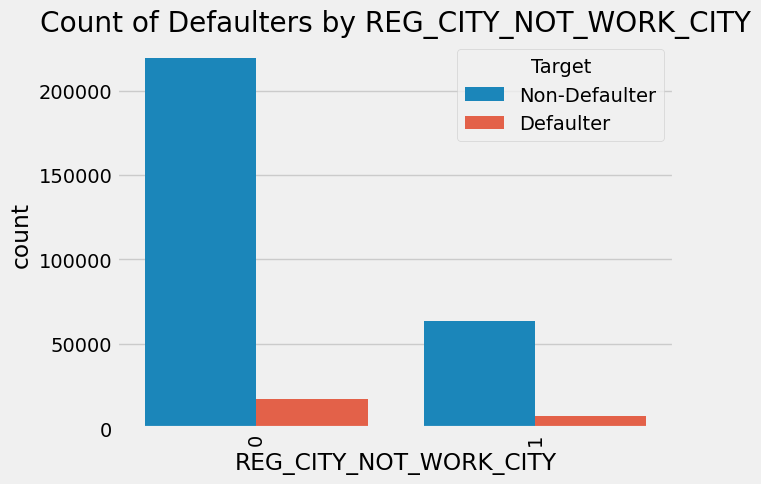

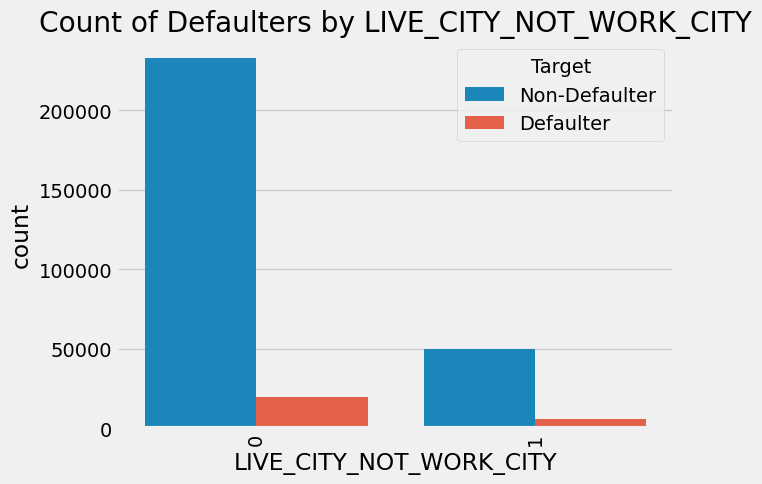

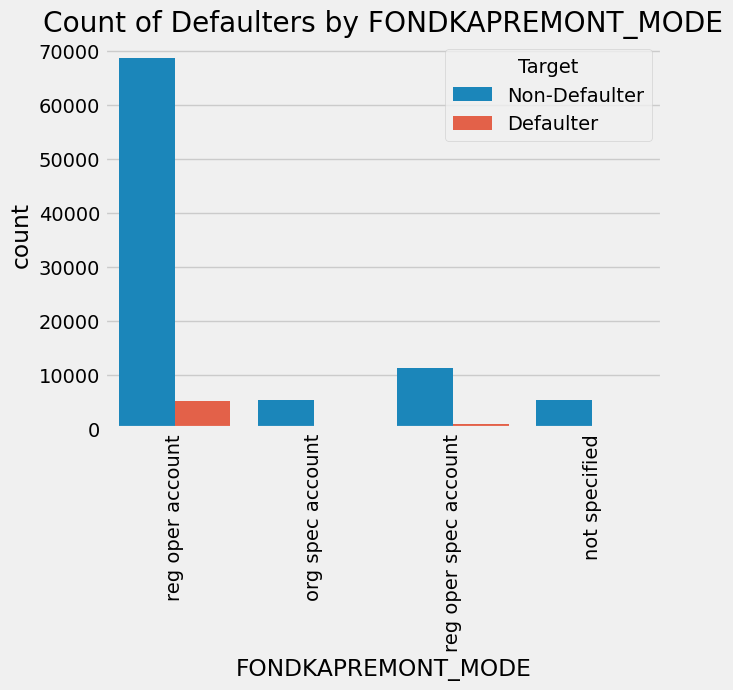

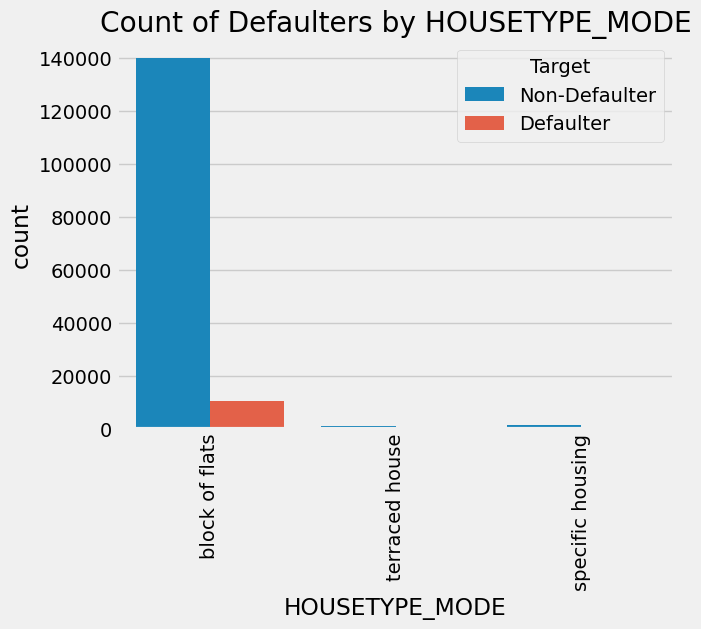

In [21]:
for col in cat_cols[0:30]:
# Define the names for the target variable
    target_names = ['Non-Defaulter', 'Defaulter']

    # Create the countplot with hue
    sns.countplot(x= col, hue="TARGET", data=df)

    # Add a title to the plot
    plt.title('Count of Defaulters by {}'.format(col))

    # Customize the legend labels
    plt.legend(title='Target', labels=target_names)
    
    plt.xticks(rotation=90)
    # Show the plot
    plt.show()

Observation:

- First we need to keep in mind is there is a great imbalance in the dataset. So, we can't conclude accurately
- based on the graphs:
1. Females are likely to repay the loan installments on time as compared to males.
2. The number of applications for cash loans are way more than the number of applications for revolving loans. Therefore, as a result of this both the people who had difficulty in repaying cash loans and the number of people who paid their cash loans on time are greater than their counterparts in both the cases.
3. People without children are more likely to repay their loans on time. But because of the existing imbalance in the data, this conclusion cannot be drawn with full certainity.
4. It can be inferred that individuals belonging to the working class are more inclined to apply for loans, and there is a high probability (90%) that they will repay the loan on time. However, due to the current imbalance in the dataset, this conclusion cannot be stated with complete certainty.
5. The number of people who are married apply for a loan are more when compared to people in other categories.
6. The count of individuals who possess a Secondary Education degree is significantly higher than those in the other education categories. Consequently, their numbers are greater in both scenarios where individuals are expected to default on their loans, as well as those where they are not expected to default.


Bi-Variate analysis of Previous Application data 

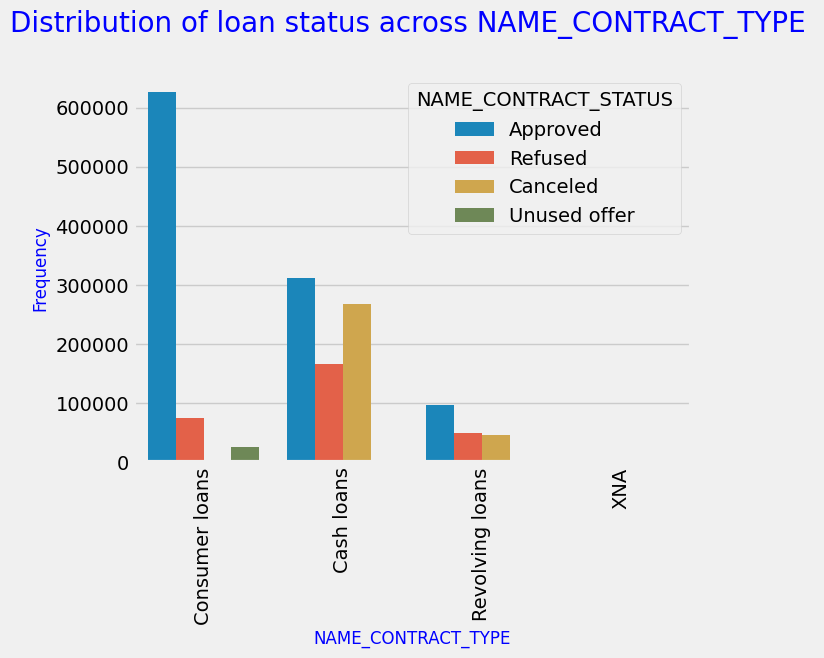

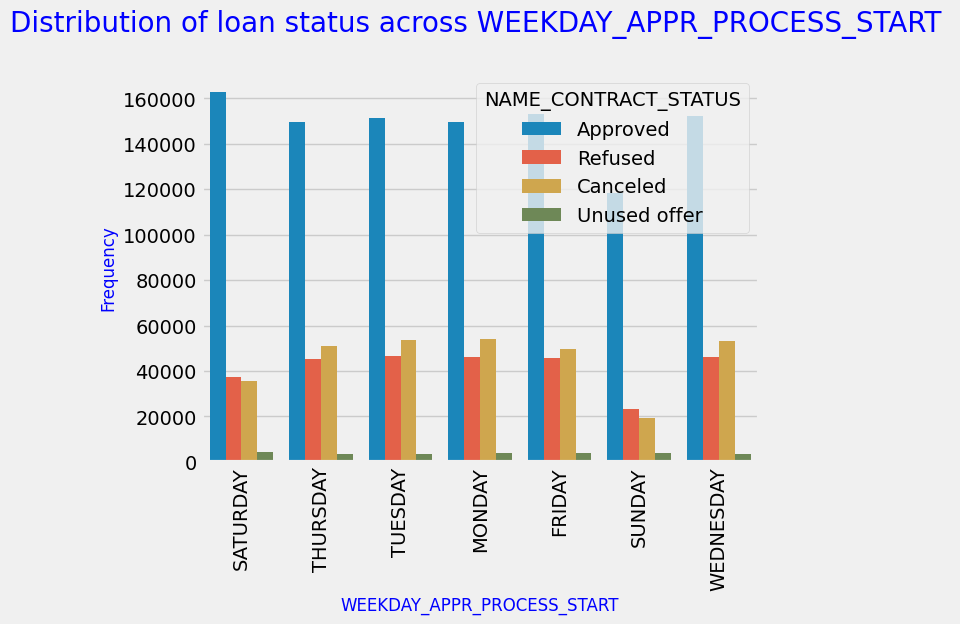

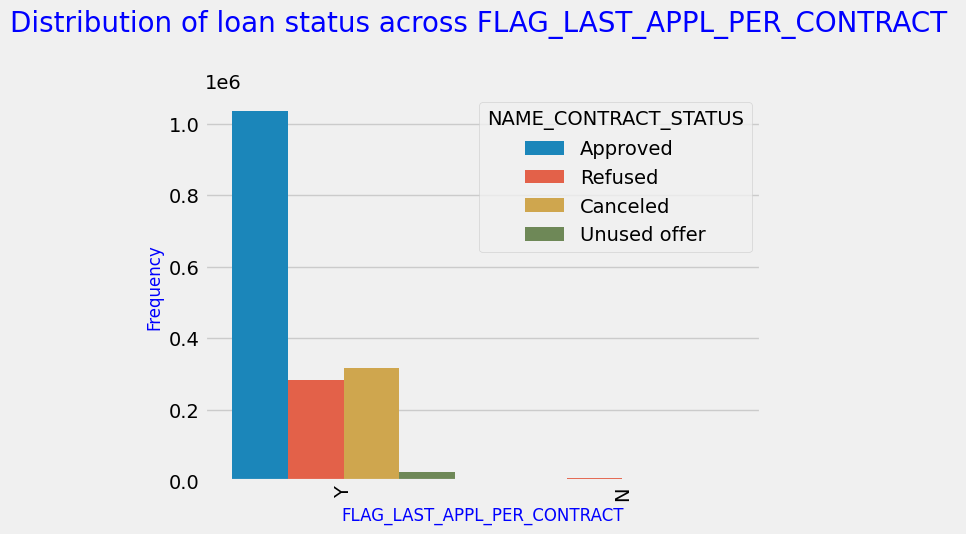

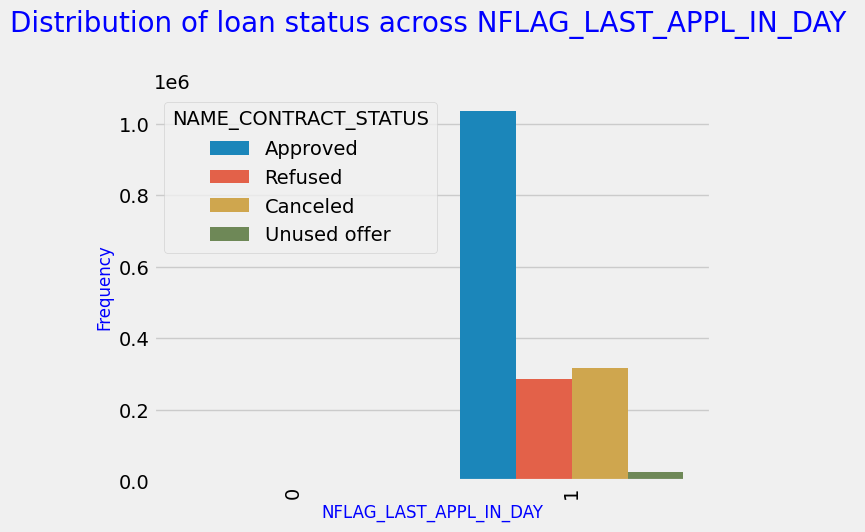

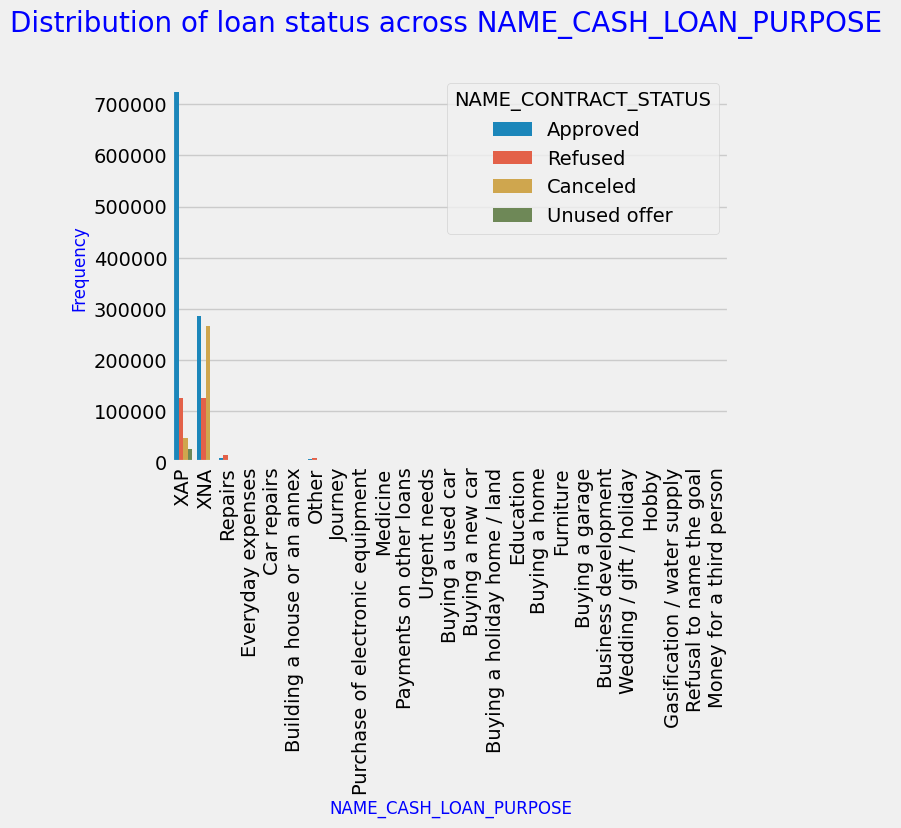

...

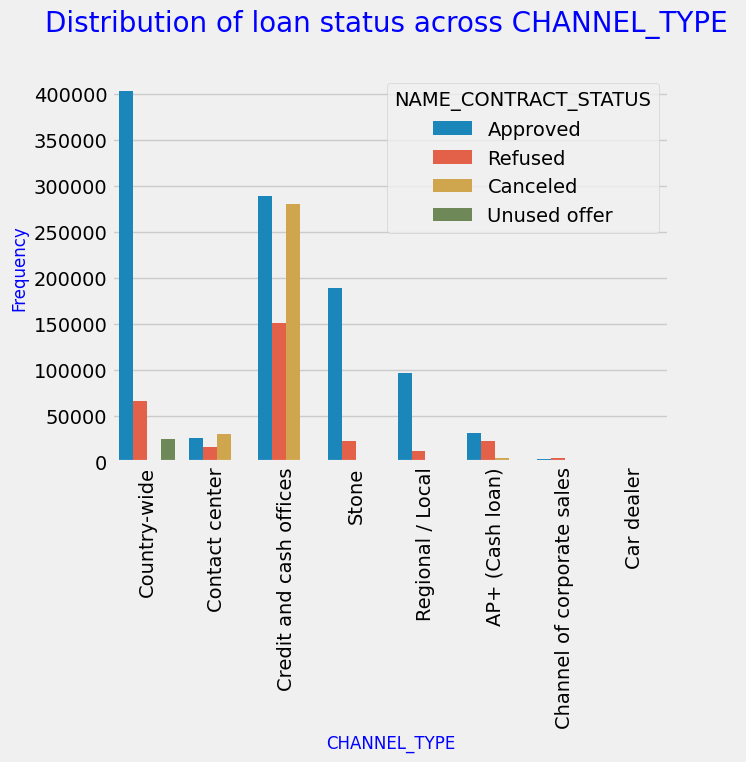

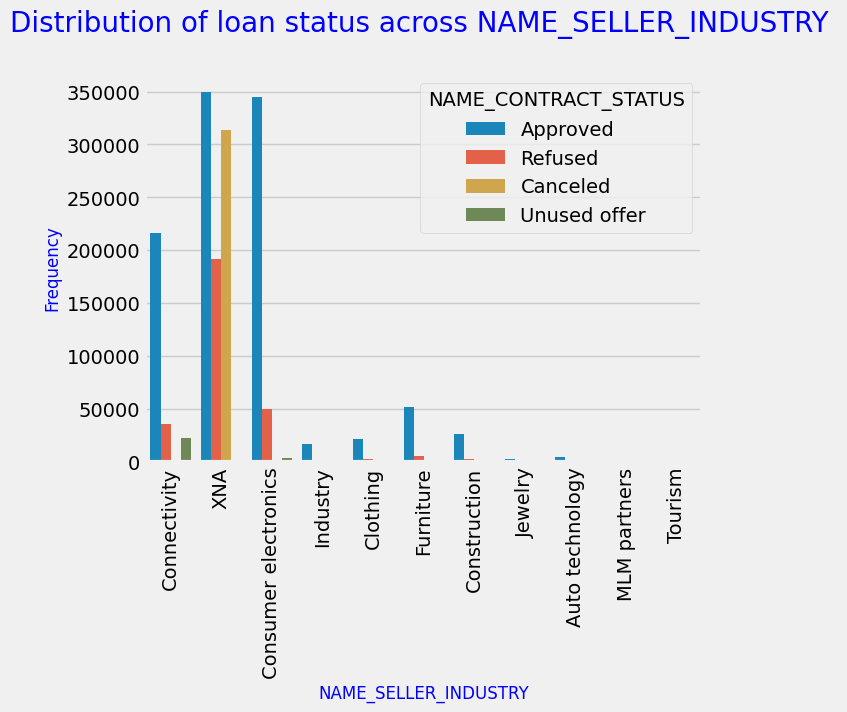

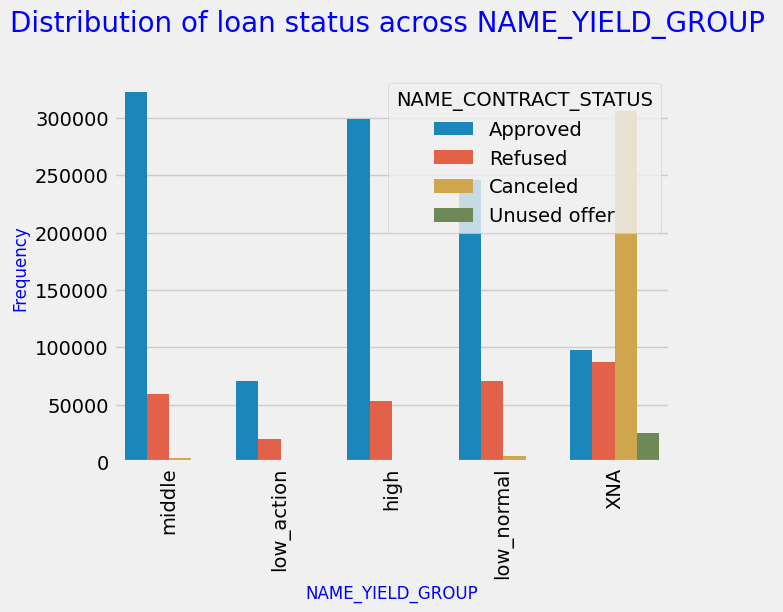

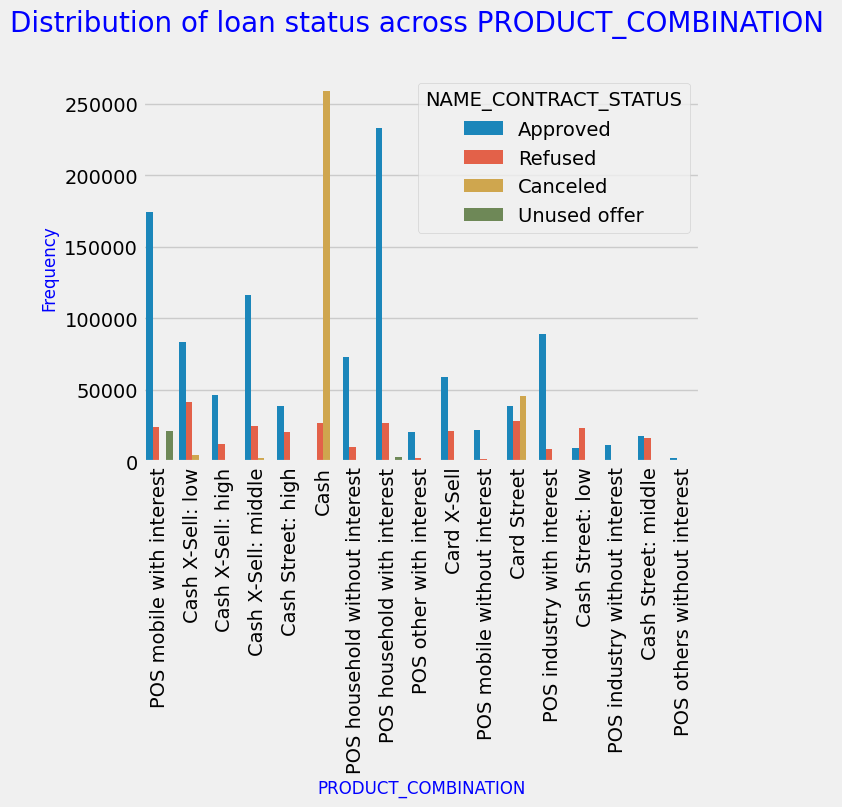

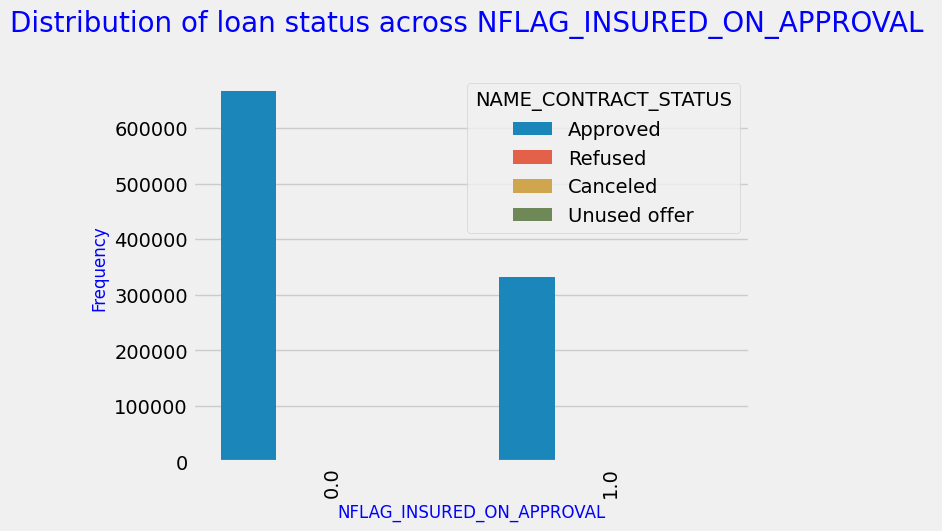

In [22]:
for col in cat_cols_previous:
    plt.style.use('fivethirtyeight')
    sns.countplot(x=df_previous[col],hue=df_previous.NAME_CONTRACT_STATUS)
    plt.title('Distribution of loan status across {} \n'.format(col),fontsize=20, color='blue')
    plt.xlabel(col, fontsize=12, color='blue')
    plt.ylabel('Frequency', fontsize=12, color='blue')
    plt.xticks(rotation=90)
    plt.show()

Observation from the above graphs:

-Consumer loans exhibit the highest approval rate, which is a logical outcome since the items purchased with these loans serve as collateral, making them a more secure form of lending from the perspective of the banks.

# Bivariate Analysis for Numerical Data

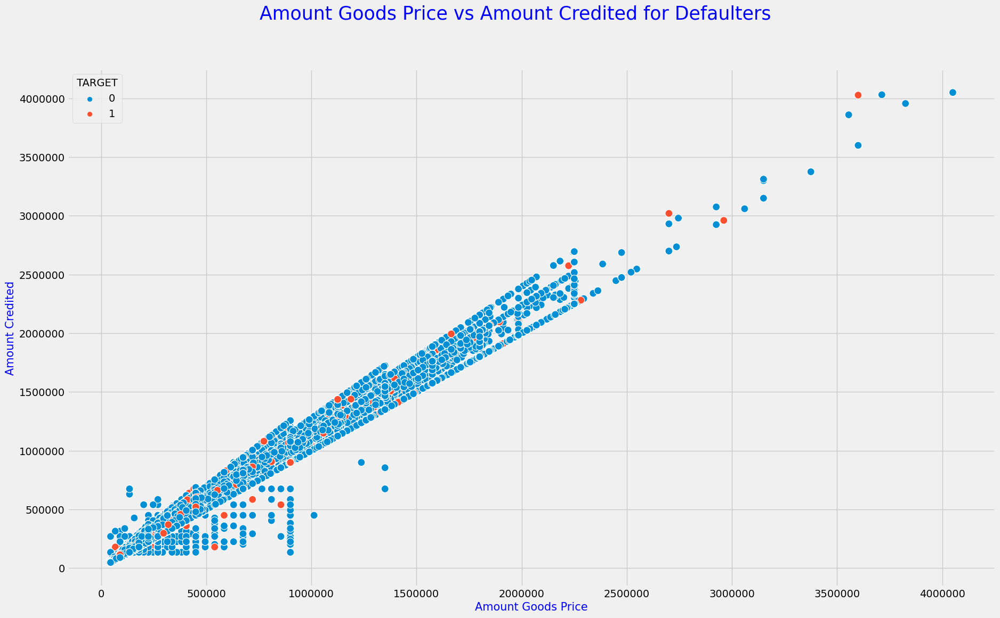

In [23]:
plt.style.use('fivethirtyeight')
plt.figure(figsize=[20,12])
sns.scatterplot(data=df, x='AMT_GOODS_PRICE', y='AMT_CREDIT',hue="TARGET",s=100)
plt.xlabel('Amount Goods Price', fontsize=15,color='blue')
plt.ylabel('Amount Credited', fontsize=15,color='blue')
plt.gcf().axes[0].yaxis.get_major_formatter().set_scientific(False)
plt.gcf().axes[0].xaxis.get_major_formatter().set_scientific(False)
plt.suptitle('Amount Goods Price vs Amount Credited for Defaulters', fontsize=25, color='blue')
plt.show()

Inference: The trend aligns with what we expected. When purchasing expensive items, higher loan amounts are required, and therefore a positive correlation should exist. This is confirmed by both plots.

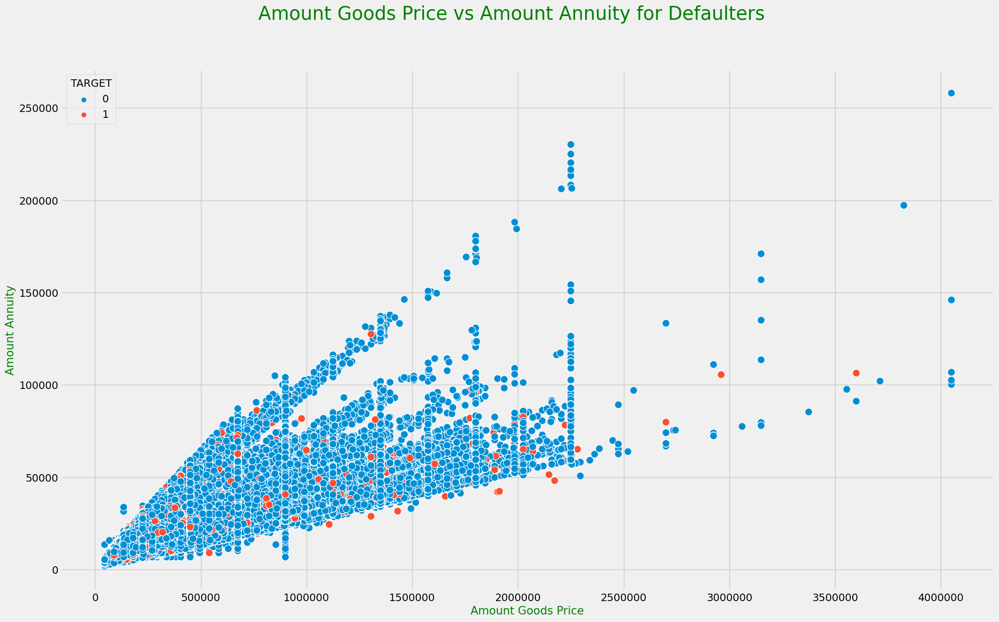

In [24]:
#Plotting AMT_GOODS_PRICE vs AMT_ANNUITY for Defaulters
plt.style.use('fivethirtyeight')
plt.figure(figsize=[20,12])
sns.scatterplot(data=df, x='AMT_GOODS_PRICE', y='AMT_ANNUITY',hue='TARGET',color='green',s=100)
plt.xlabel('Amount Goods Price', fontsize=15,color='green')
plt.ylabel('Amount Annuity', fontsize=15,color='green')
plt.gcf().axes[0].yaxis.get_major_formatter().set_scientific(False)
plt.gcf().axes[0].xaxis.get_major_formatter().set_scientific(False)
plt.suptitle('Amount Goods Price vs Amount Annuity for Defaulters', fontsize=25, color='green')
plt.show()

Inference: Items that are expensive require higher loan amounts, and with higher loan amounts comes higher annuity payments. Therefore, there should be a positive correlation between the price of goods and the annuity amount, which is observed in the data. This aligns with our expectations and understanding of the relationship between loan amounts, annuity payments, and expensive purchases.

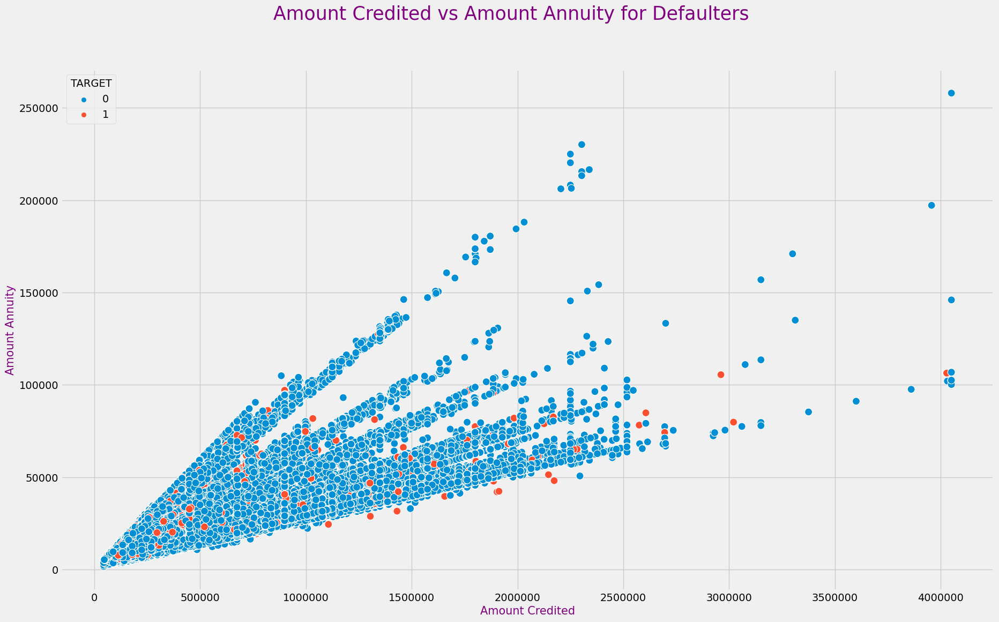

In [25]:
#Plotting AMT_CREDIT vs AMT_ANNUITY for Defaulters
plt.style.use('fivethirtyeight')
plt.figure(figsize=[20,12])
sns.scatterplot(data=df, x='AMT_CREDIT', y='AMT_ANNUITY',hue="TARGET",color='purple',s=100)
plt.xlabel('Amount Credited', fontsize=15,color='purple')
plt.ylabel('Amount Annuity', fontsize=15,color='purple')
plt.gcf().axes[0].yaxis.get_major_formatter().set_scientific(False)
plt.gcf().axes[0].xaxis.get_major_formatter().set_scientific(False)
plt.suptitle('Amount Credited vs Amount Annuity for Defaulters', fontsize=25, color='purple')
plt.show()

Inference: The general understanding is that higher loan amounts lead to higher annuity payments, and this relationship is also observed in this plot. Therefore, this plot aligns with our expectations and understanding of the relationship between credited loan amounts and annuity payments.

# Bivariate Analysis for Numerical Data for Previous application data

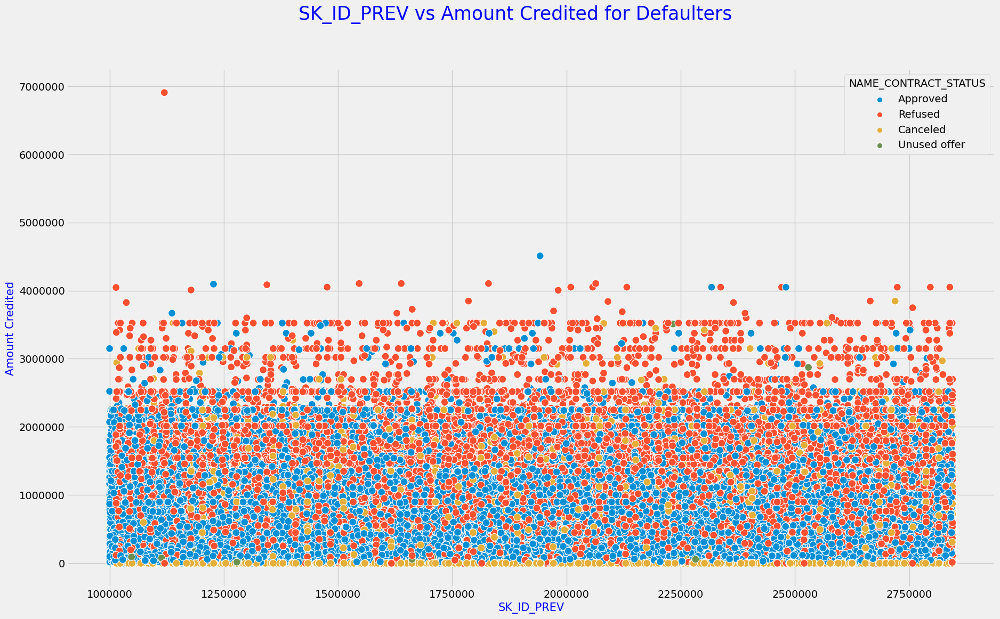

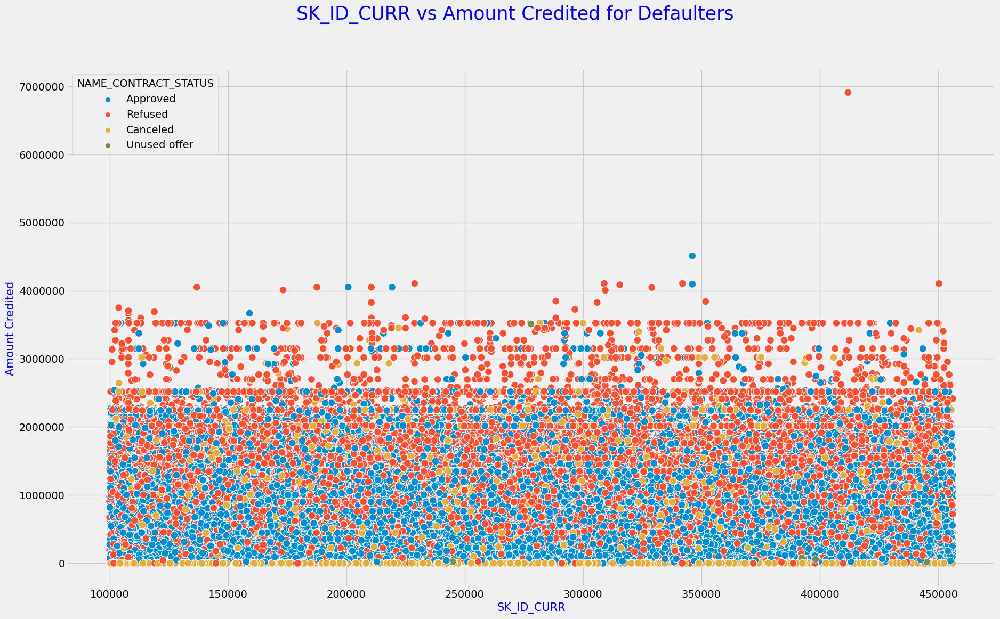

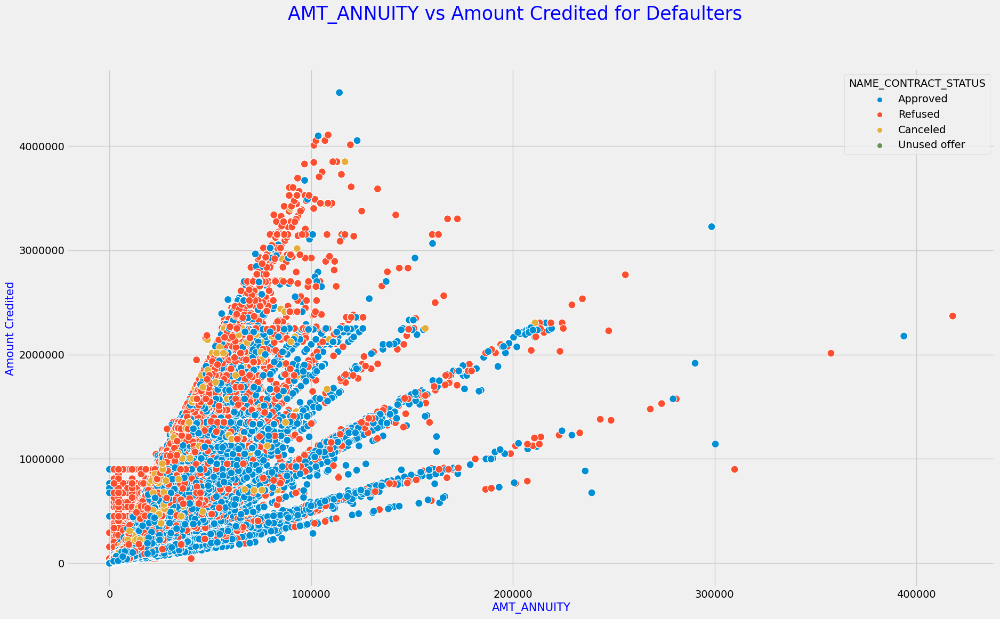

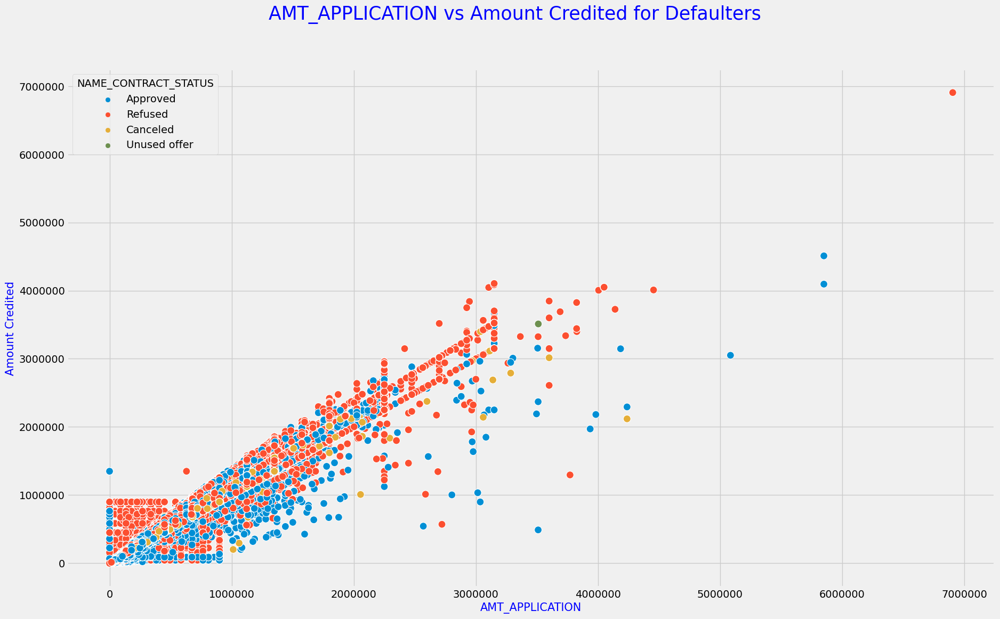

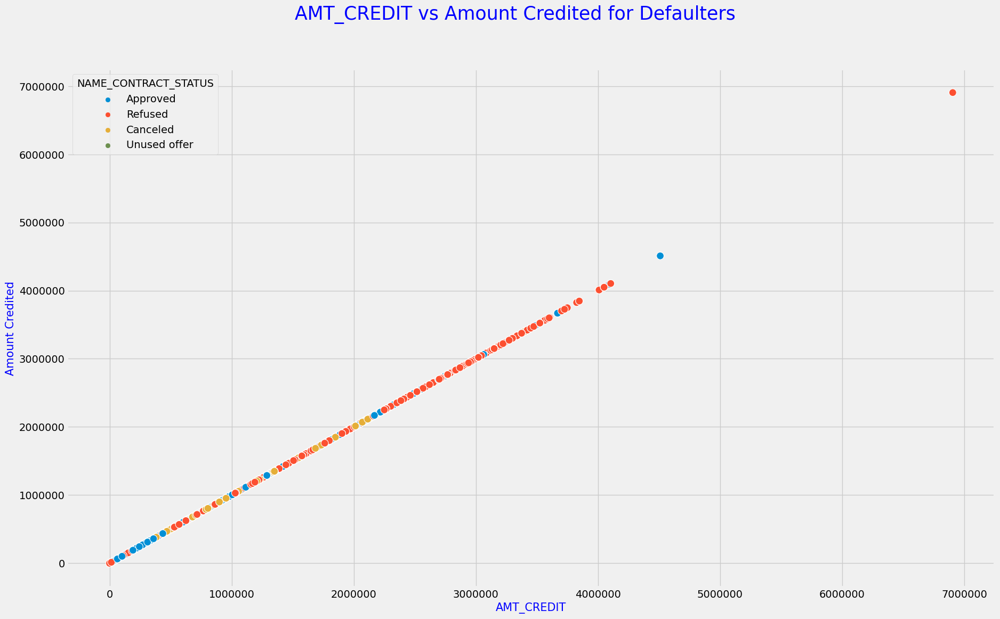

...

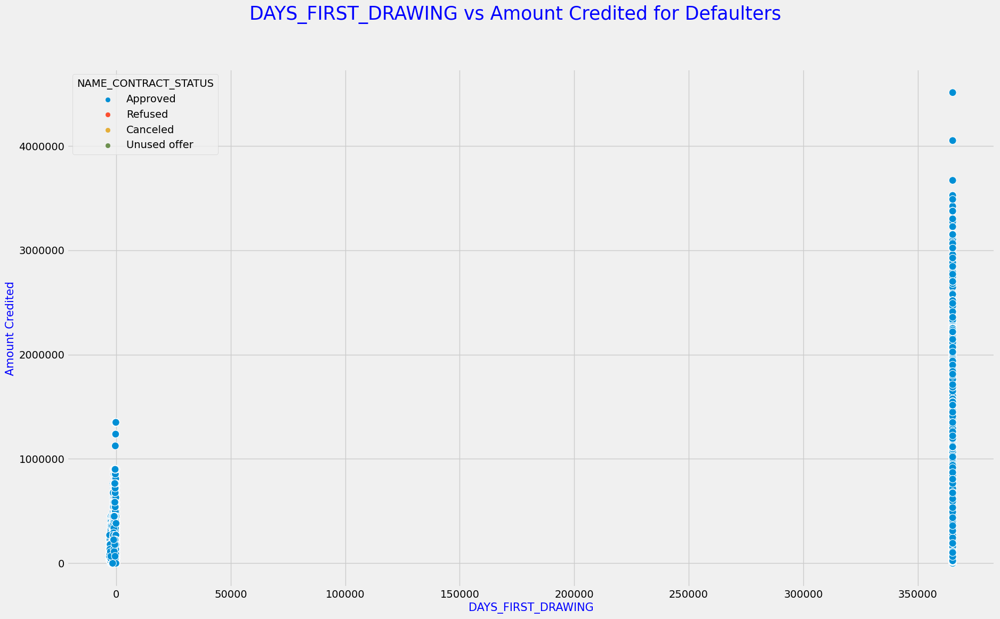

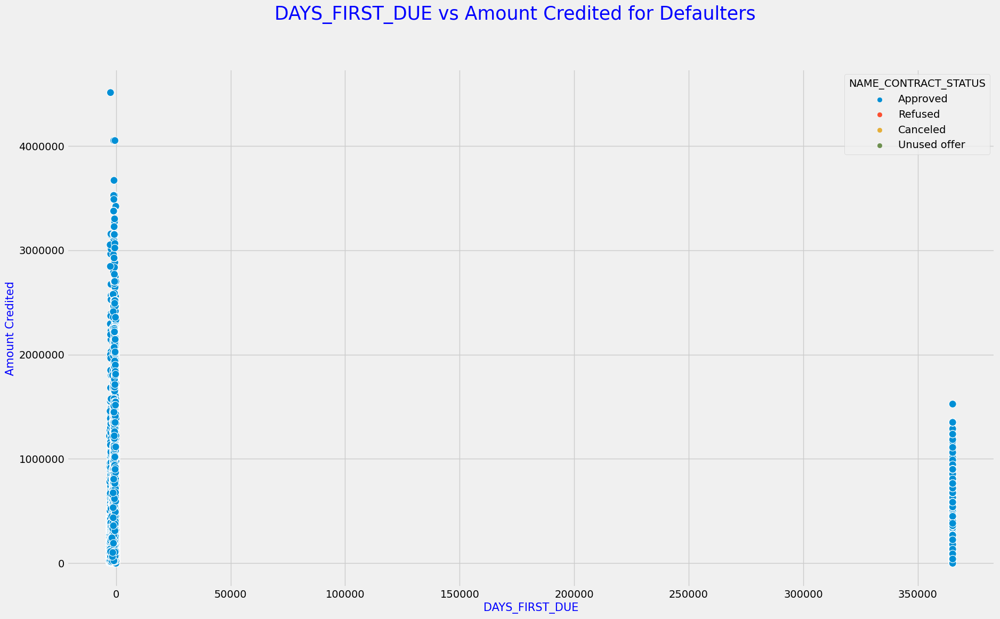

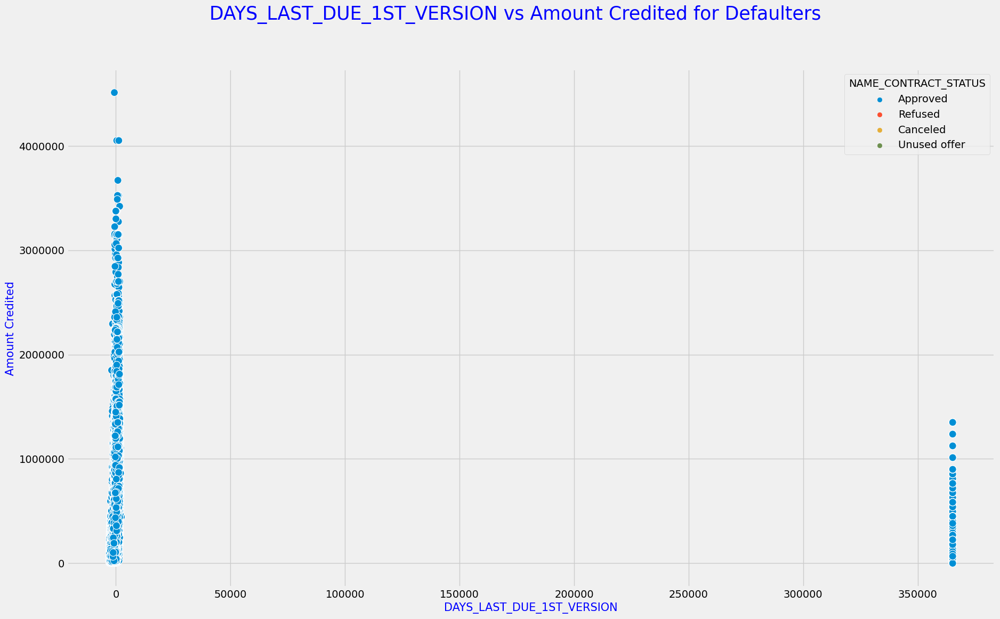

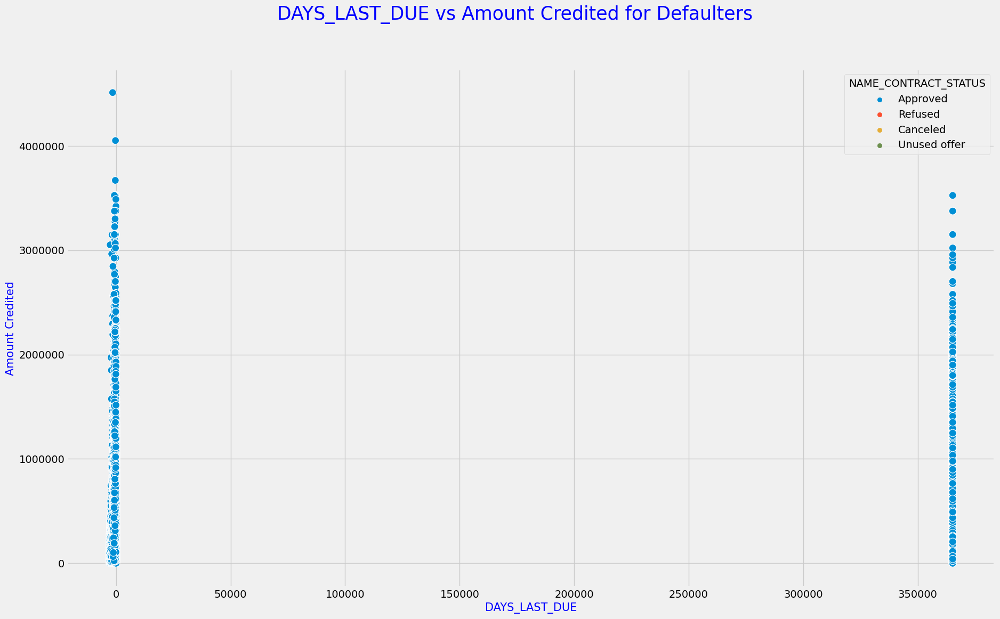

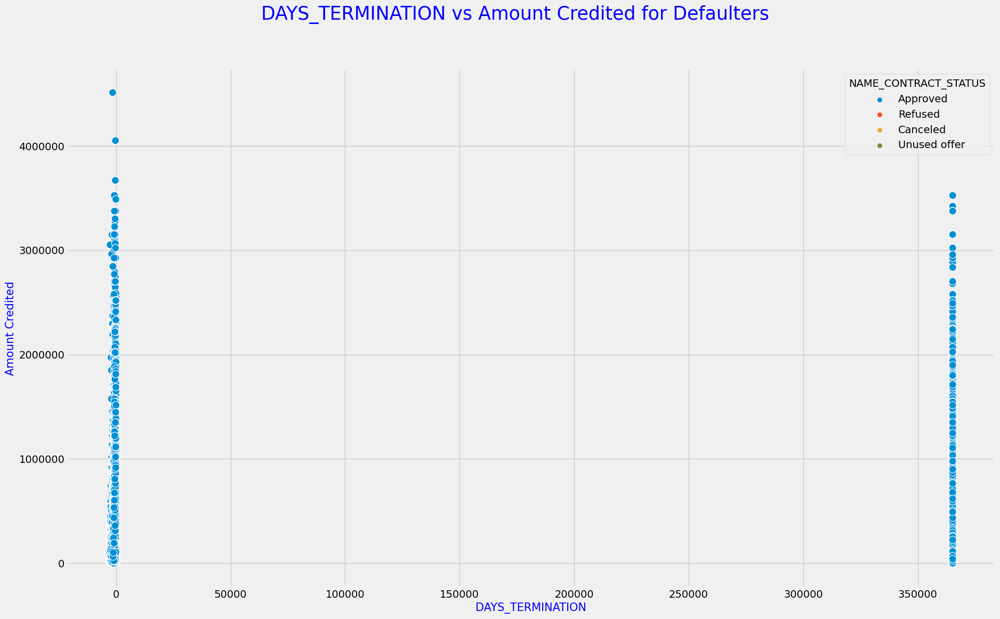

In [26]:
for col in num_cols_previous:
    plt.style.use('fivethirtyeight')
    plt.figure(figsize=[20,12])
    sns.scatterplot(data=df_previous, x=col, y='AMT_CREDIT',hue="NAME_CONTRACT_STATUS",s=100)
    plt.xlabel(col, fontsize=15,color='blue')
    plt.ylabel('Amount Credited', fontsize=15,color='blue')
    plt.gcf().axes[0].yaxis.get_major_formatter().set_scientific(False)
    plt.gcf().axes[0].xaxis.get_major_formatter().set_scientific(False)
    plt.suptitle('{} vs Amount Credited for Defaulters'.format(col), fontsize=25, color='blue')
    plt.show()

Observation:
- from the above graphs, we can't get much insights regarding approval or rejection of the loan 
- But we can see a correlation between a few features 
- Amount application and amount credited has a positive correlation.
- Amount down payment and amount credited also has a bit of positive correaltion.


# Correalation Analysis

In [32]:
df2

,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,...,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG
0,100002,0,202500.0,406597.5,24700.5,351000.0,0.018801,-9461,-637,-3648.0,...,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833
1,100003,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188,-1186.0,...,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917
2,100004,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225,-4260.0,...,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,100006,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039,-9833.0,...,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038,-4311.0,...,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,157500.0,254700.0,27558.0,225000.0,0.032561,-9327,-236,-8456.0,...,0.681632,NaN,0.2021,0.0887,0.9876,0.8300,0.0202,0.22,0.1034,0.6042
307507,456252,0,72000.0,269550.0,12001.5,225000.0,0.025164,-20775,365243,-4388.0,...,0.115992,NaN,0.0247,0.0435,0.9727,0.6260,0.0022,0.00,0.1034,0.0833
307508,456253,0,153000.0,677664.0,29979.0,585000.0,0.005002,-14966,-7921,-6737.0,...,0.535722,0.218859,0.1031,0.0862,0.9816,0.7484,0.0123,0.00,0.2069,0.1667
307509,456254,0,171000.0,370107.0,20205.0,319500.0,0.005313,-11961,-4786,-2562.0,...,0.514163,0.661024,0.0124,NaN,0.9771,NaN,NaN,NaN,0.0690,0.0417


,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,...,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG
SK_ID_CURR,1.000000,-0.001129,-0.001820,-0.000343,-0.000433,-0.000232,0.000849,-0.001500,0.001366,-0.000973,...,0.002342,0.000222,0.001556,-0.002070,0.001551,0.005900,-0.001463,0.004862,-0.002879,0.004851
CNT_CHILDREN,-0.001129,1.000000,0.012882,0.002145,0.021374,-0.001827,-0.025573,0.330938,-0.239818,0.183395,...,-0.018015,-0.042710,-0.013222,-0.008464,0.006902,0.030172,0.000140,-0.007060,-0.008341,-0.009705
AMT_INCOME_TOTAL,-0.001820,0.012882,1.000000,0.156870,0.191657,0.159610,0.074796,0.027261,-0.064223,0.027805,...,0.060925,-0.030229,0.034501,0.017303,0.005658,0.042334,0.089616,0.045053,0.005394,0.060171
AMT_CREDIT,-0.000343,0.002145,0.156870,1.000000,0.770138,0.986968,0.099738,-0.055436,-0.066838,0.009621,...,0.131228,0.043516,0.060439,0.039226,0.006249,0.035875,0.049537,0.080635,0.014929,0.103296
AMT_ANNUITY,-0.000433,0.021374,0.191657,0.770138,1.000000,0.775109,0.118429,0.009445,-0.104332,0.038514,...,0.125804,0.030752,0.076213,0.044507,0.013298,0.034195,0.057628,0.101439,0.014745,0.130174
AMT_GOODS_PRICE,-0.000232,-0.001827,0.159610,0.986968,0.775109,1.000000,0.103520,-0.053442,-0.064842,0.011565,...,0.139367,0.047717,0.064918,0.043982,0.007245,0.041937,0.050507,0.083736,0.018764,0.108512
REGION_POPULATION_RELATIVE,0.000849,-0.025573,0.074796,0.099738,0.118429,0.103520,1.000000,-0.029582,-0.003980,-0.053820,...,0.198924,-0.006001,0.205942,0.098423,-0.006683,-0.056566,0.164806,0.280685,0.036840,0.322652
DAYS_BIRTH,-0.001500,0.330938,0.027261,-0.055436,0.009445,-0.053442,-0.029582,1.000000,-0.615864,0.331912,...,-0.091996,-0.205478,0.004779,-0.004400,0.000744,0.026623,0.008364,-0.001448,-0.010281,0.001634
DAYS_EMPLOYED,0.001366,-0.239818,-0.064223,-0.066838,-0.104332,-0.064842,-0.003980,-0.615864,1.000000,-0.210242,...,-0.020767,0.113434,-0.016359,-0.001382,0.008629,-0.005830,-0.012528,-0.009792,0.004018,-0.015970
DAYS_REGISTRATION,-0.000973,0.183395,0.027805,0.009621,0.038514,0.011565,-0.053820,0.331912,-0.210242,1.000000,...,-0.059913,-0.107549,0.013186,-0.020729,0.011035,0.164184,0.028300,0.000746,-0.063094,0.049701


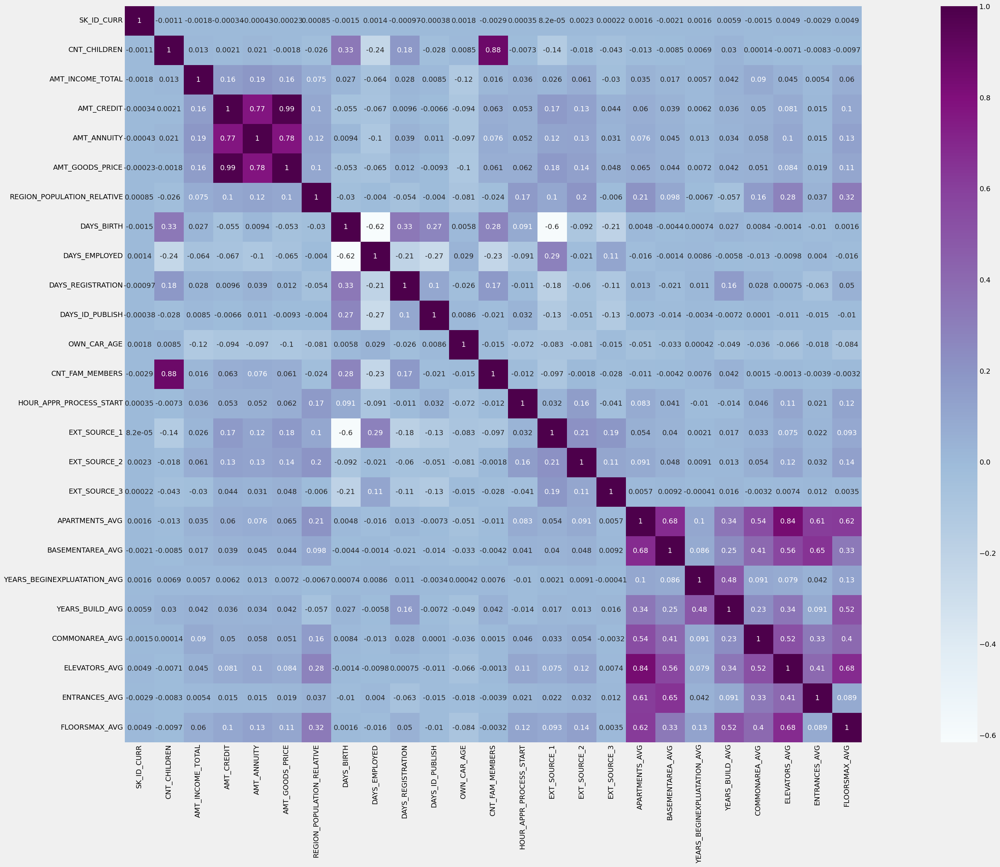

In [33]:
matrix = df2.corr()
f, ax = plt.subplots(figsize=(50, 25))
sns.heatmap(matrix, vmax=1, square=True, cmap="BuPu", annot=True)

matrix

In [34]:
Had_Issues=df[df['TARGET']==1] #People who had issues in repayment
Had_No_Issues=df[df['TARGET']==0]

In [36]:
corr_app_col = ['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','AMT_GOODS_PRICE','DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION','CNT_CHILDREN','CNT_FAM_MEMBERS', 'APARTMENTS_AVG','LANDAREA_AVG']
df_app_corr = df[corr_app_col]

In [37]:
corr_prev_cols = ['AMT_ANNUITY','AMT_CREDIT','AMT_DOWN_PAYMENT','AMT_GOODS_PRICE','RATE_DOWN_PAYMENT','RATE_INTEREST_PRIVILEGED','CNT_PAYMENT', 'DAYS_FIRST_DUE','DAYS_LAST_DUE_1ST_VERSION','DAYS_LAST_DUE', 'DAYS_TERMINATION']
df_prev_corr = df_previous[corr_prev_cols]

In [38]:
df_prev_corr = df_previous[corr_prev_cols]

In [39]:
len(num_cols_previous)

19

In [40]:
len(cat_cols_previous)

18

In [41]:
df3 = df_previous[num_cols_previous]

In [42]:
df3.shape

(1670214, 19)

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION
SK_ID_PREV,1.000000,-0.000321,0.011459,0.003302,0.003659,-0.001313,0.015293,-0.002652,-0.004051,0.012969,-0.022312,0.019100,-0.001079,0.015589,-0.001478,-0.000071,0.001222,0.001915,0.001781
SK_ID_CURR,-0.000321,1.000000,0.000577,0.000280,0.000195,-0.000063,0.000369,0.002842,0.001158,0.033197,-0.016757,-0.000637,0.001265,0.000031,-0.001329,-0.000757,0.000252,-0.000318,-0.000020
AMT_ANNUITY,0.011459,0.000577,1.000000,0.808872,0.816429,0.267694,0.820895,-0.036201,-0.103878,0.141823,-0.202335,0.279051,-0.015027,0.394535,0.052839,-0.053295,-0.068877,0.082659,0.068022
AMT_APPLICATION,0.003302,0.000280,0.808872,1.000000,0.975824,0.482776,0.999884,-0.014415,-0.072479,0.110001,-0.199733,0.133660,-0.007649,0.680630,0.074544,-0.049532,-0.084905,0.172627,0.148618
AMT_CREDIT,0.003659,0.000195,0.816429,0.975824,1.000000,0.301284,0.993087,-0.021039,-0.188128,0.125106,-0.205158,0.133763,-0.009567,0.674278,-0.036813,0.002881,0.044031,0.224829,0.214320
AMT_DOWN_PAYMENT,-0.001313,-0.000063,0.267694,0.482776,0.301284,1.000000,0.482776,0.016776,0.473935,0.016323,-0.115343,-0.024536,0.003533,0.031659,-0.001773,-0.013586,-0.000869,-0.031425,-0.030702
AMT_GOODS_PRICE,0.015293,0.000369,0.820895,0.999884,0.993087,0.482776,1.000000,-0.045267,-0.072479,0.110001,-0.199733,0.290422,-0.015842,0.672129,-0.024445,-0.021062,0.016883,0.211696,0.209296
HOUR_APPR_PROCESS_START,-0.002652,0.002842,-0.036201,-0.014415,-0.021039,0.016776,-0.045267,1.000000,0.025930,-0.027172,-0.045720,-0.039962,0.015671,-0.055511,0.014321,-0.002797,-0.016567,-0.018018,-0.018254
RATE_DOWN_PAYMENT,-0.004051,0.001158,-0.103878,-0.072479,-0.188128,0.473935,-0.072479,0.025930,1.000000,-0.103373,-0.106143,-0.208742,-0.006489,-0.278875,-0.007969,-0.039178,-0.010934,-0.147562,-0.145461
RATE_INTEREST_PRIMARY,0.012969,0.033197,0.141823,0.110001,0.125106,0.016323,0.110001,-0.027172,-0.103373,1.000000,-0.001937,0.014037,0.159182,-0.019030,NaN,-0.017171,-0.000933,-0.010677,-0.011099


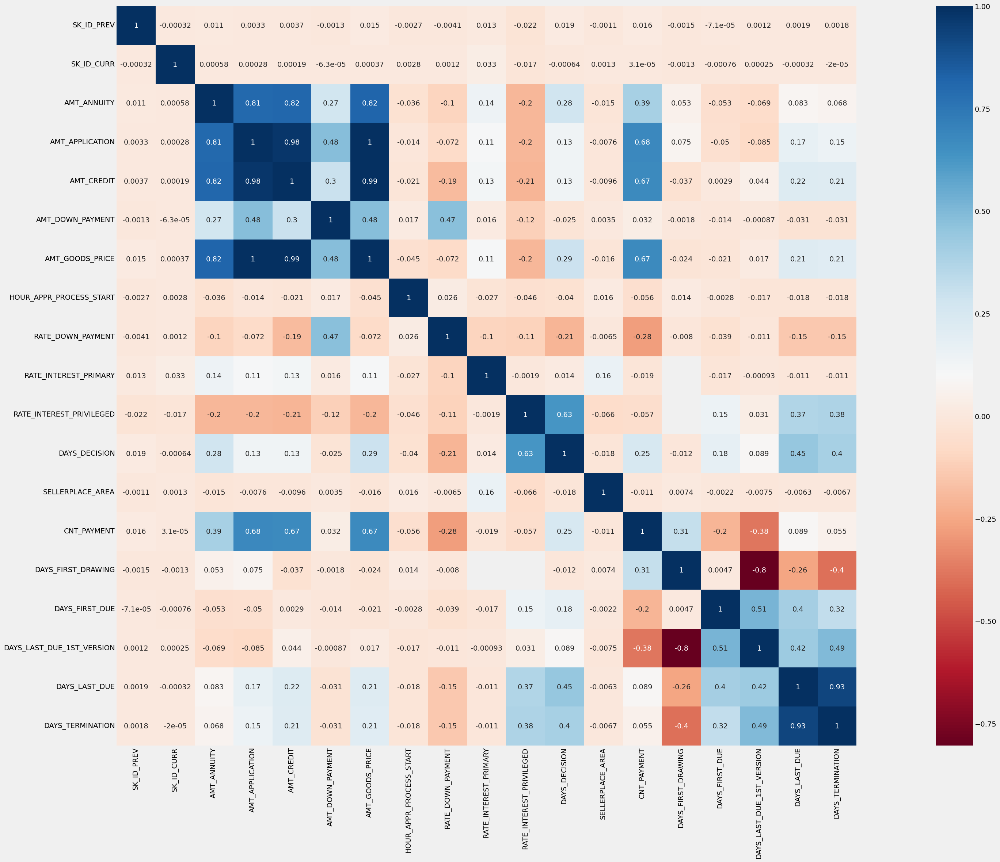

In [43]:
matrix = df3.corr()
f, ax = plt.subplots(figsize=(50, 25))
sns.heatmap(matrix, vmax=1, square=True,cmap='RdBu', annot=True)

matrix

,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,CNT_CHILDREN,CNT_FAM_MEMBERS,APARTMENTS_AVG,LANDAREA_AVG
AMT_INCOME_TOTAL,1.000000,0.156870,0.191657,0.159610,0.027261,-0.064223,0.027805,0.012882,0.016342,0.034501,-0.001598
AMT_CREDIT,0.156870,1.000000,0.770138,0.986968,-0.055436,-0.066838,0.009621,0.002145,0.063160,0.060439,0.006218
AMT_ANNUITY,0.191657,0.770138,1.000000,0.775109,0.009445,-0.104332,0.038514,0.021374,0.075539,0.076213,0.008611
AMT_GOODS_PRICE,0.159610,0.986968,0.775109,1.000000,-0.053442,-0.064842,0.011565,-0.001827,0.061185,0.064918,0.013297
DAYS_BIRTH,0.027261,-0.055436,0.009445,-0.053442,1.000000,-0.615864,0.331912,0.330938,0.278894,0.004779,0.003013
DAYS_EMPLOYED,-0.064223,-0.066838,-0.104332,-0.064842,-0.615864,1.000000,-0.210242,-0.239818,-0.233549,-0.016359,-0.009609
DAYS_REGISTRATION,0.027805,0.009621,0.038514,0.011565,0.331912,-0.210242,1.000000,0.183395,0.173416,0.013186,0.003109
CNT_CHILDREN,0.012882,0.002145,0.021374,-0.001827,0.330938,-0.239818,0.183395,1.000000,0.879161,-0.013222,-0.003121
CNT_FAM_MEMBERS,0.016342,0.063160,0.075539,0.061185,0.278894,-0.233549,0.173416,0.879161,1.000000,-0.011033,0.001604
APARTMENTS_AVG,0.034501,0.060439,0.076213,0.064918,0.004779,-0.016359,0.013186,-0.013222,-0.011033,1.000000,0.496852


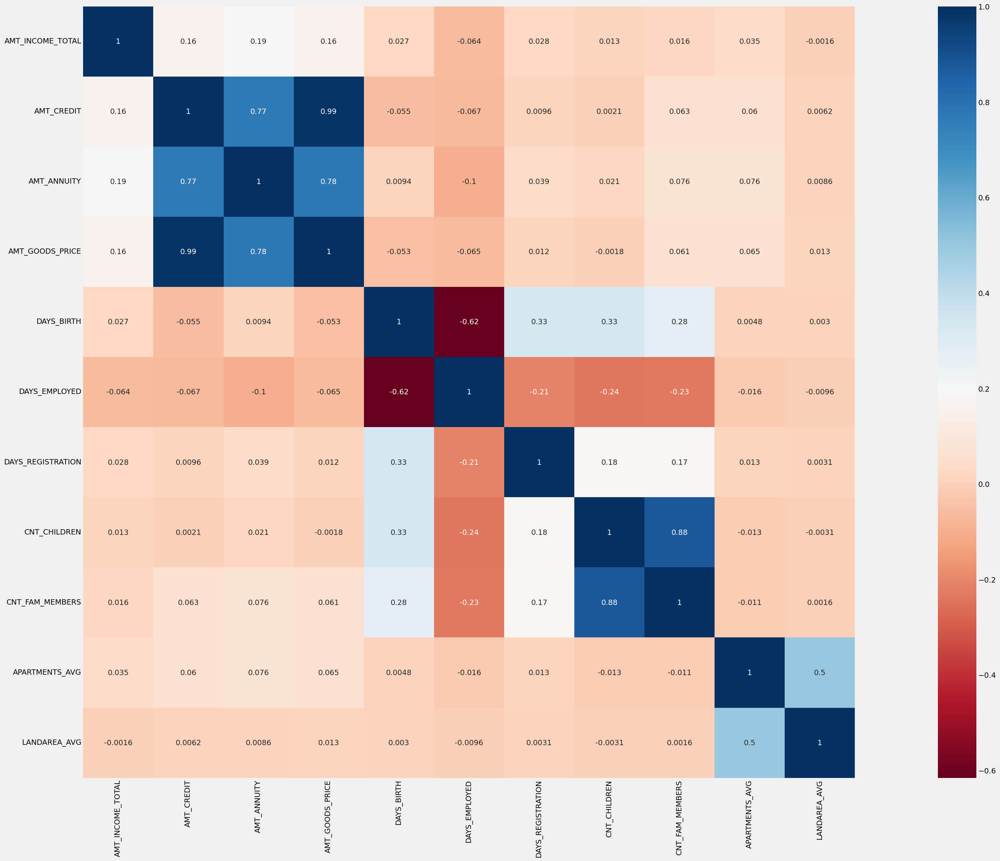

In [44]:
matrix = df_app_corr.corr()
f, ax = plt.subplots(figsize=(50, 25))
sns.heatmap(matrix, vmax=1, square=True,cmap='RdBu', annot=True)

matrix

,AMT_ANNUITY,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIVILEGED,CNT_PAYMENT,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION
AMT_ANNUITY,1.000000,0.816429,0.267694,0.820895,-0.103878,-0.202335,0.394535,-0.053295,-0.068877,0.082659,0.068022
AMT_CREDIT,0.816429,1.000000,0.301284,0.993087,-0.188128,-0.205158,0.674278,0.002881,0.044031,0.224829,0.214320
AMT_DOWN_PAYMENT,0.267694,0.301284,1.000000,0.482776,0.473935,-0.115343,0.031659,-0.013586,-0.000869,-0.031425,-0.030702
AMT_GOODS_PRICE,0.820895,0.993087,0.482776,1.000000,-0.072479,-0.199733,0.672129,-0.021062,0.016883,0.211696,0.209296
RATE_DOWN_PAYMENT,-0.103878,-0.188128,0.473935,-0.072479,1.000000,-0.106143,-0.278875,-0.039178,-0.010934,-0.147562,-0.145461
RATE_INTEREST_PRIVILEGED,-0.202335,-0.205158,-0.115343,-0.199733,-0.106143,1.000000,-0.057150,0.150904,0.030513,0.372214,0.378671
CNT_PAYMENT,0.394535,0.674278,0.031659,0.672129,-0.278875,-0.057150,1.000000,-0.204907,-0.381013,0.088903,0.055121
DAYS_FIRST_DUE,-0.053295,0.002881,-0.013586,-0.021062,-0.039178,0.150904,-0.204907,1.000000,0.513949,0.401838,0.323608
DAYS_LAST_DUE_1ST_VERSION,-0.068877,0.044031,-0.000869,0.016883,-0.010934,0.030513,-0.381013,0.513949,1.000000,0.423462,0.493174
DAYS_LAST_DUE,0.082659,0.224829,-0.031425,0.211696,-0.147562,0.372214,0.088903,0.401838,0.423462,1.000000,0.927990


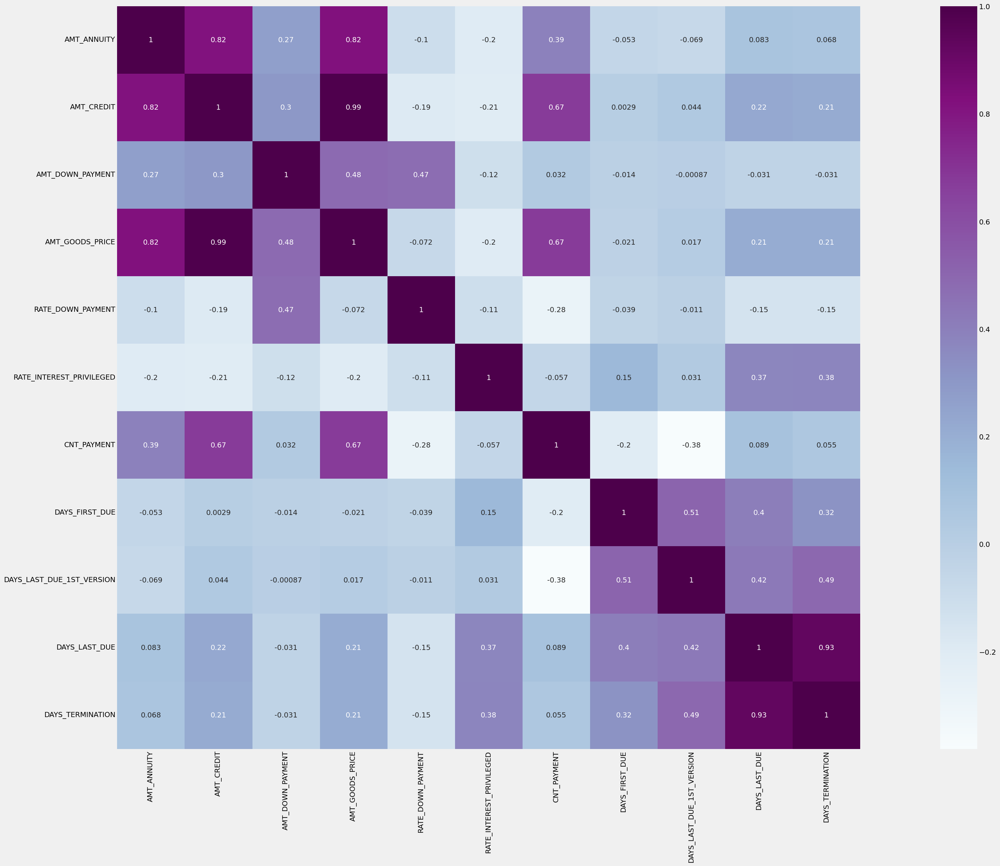

In [45]:
matrix = df_prev_corr.corr()
f, ax = plt.subplots(figsize=(50, 25))
sns.heatmap(matrix, vmax=1, square=True, cmap="BuPu", annot=True)

matrix